#**Thai sentiment analysis about education in Thailand on Twitter.** 🙂😐☹️

# การนำเข้าแพ็คเกจที่จำเป็น

In [ ]:
import pandas as pd
import tweepy as tw
import numpy as np 

from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report

import warnings 
warnings.filterwarnings("ignore", category=DeprecationWarning)

%matplotlib inline

# Model process ⚙️🔨

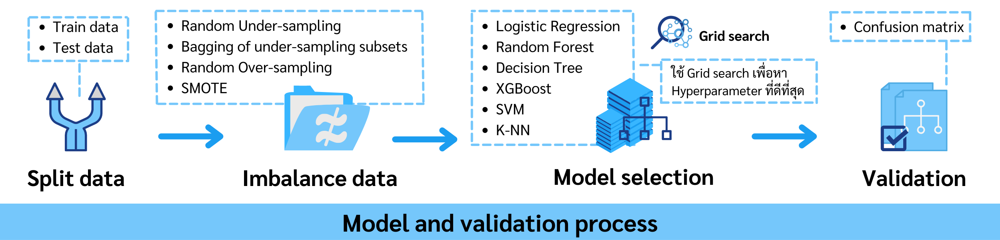

## Load pickle files

In [ ]:
import pickle
# load the TFIDF from disk
TFIDF = pickle.load(open('TFIDF.pkl', 'rb'))

# load the label from disk
label = pickle.load(open('label.pkl', 'rb'))

## Split data

In [ ]:
from sklearn.model_selection import train_test_split # ทำการแบ่งข้อมูลฝึกสอนและทดสอบ
X = TFIDF
y = label
# ข้อมูลฝึกสอนและทดสอบ
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3, random_state = 0)

In [ ]:
# ขนาดข้อมูลฝึกสอนและทดสอบ
X_train.shape, y_train.shape, X_test.shape, y_test.shape

((4096, 1000), (4096,), (1756, 1000), (1756,))

In [ ]:
y_train.value_counts() # y train

-1    2339
0     1571
1      186
Name: category, dtype: int64

In [ ]:
y_test.value_counts() # y test

-1    1007
0      678
1       71
Name: category, dtype: int64

## Model 👩🏼‍💻💻 


### Logistic Regression

**Hyperparameters**   
LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
          intercept_scaling=1, max_iter=100, multi_class='ovr', n_jobs=1,
          penalty='l2', random_state=None, solver='liblinear', tol=0.0001,
          verbose=0, warm_start=False)

In [ ]:
from sklearn.linear_model import LogisticRegression
Log_Reg = LogisticRegression(random_state = 0,solver = 'lbfgs', C=1) #Hyperparameters

In [ ]:
Log_Reg.fit(X_train,y_train)

LogisticRegression(C=1, random_state=0)

In [ ]:
prediction_tfidf = Log_Reg.predict_proba(X_test)
prediction_tfidf  = np.argmax(prediction_tfidf ,axis=1)
prediction_int = prediction_tfidf -1

In [ ]:
from sklearn.metrics import f1_score
# if prediction is greater than or equal to 0.3 than 1 else 0
# Where 0 is for positive sentiment tweets and 1 for negative sentiment tweets
#prediction_int = prediction_tfidf[:,1]>=0.3

prediction_int = prediction_int.astype(np.int)
prediction_int

# calculating f1 score
#log_tfidf = f1_score(y_test.apply(pd.to_numeric), prediction_int, average='weighted')
log_tfidf = f1_score(y_test.apply(pd.to_numeric), prediction_int, average='weighted')

log_tfidf

0.6608089530459628

In [ ]:
from sklearn.metrics import classification_report
print(classification_report(y_test.apply(pd.to_numeric), prediction_int))

              precision    recall  f1-score   support

          -1       0.73      0.77      0.75      1007
           0       0.59      0.59      0.59       678
           1       1.00      0.04      0.08        71

    accuracy                           0.67      1756
   macro avg       0.77      0.47      0.47      1756
weighted avg       0.68      0.67      0.66      1756



#### grid search cv

In [ ]:
from sklearn.model_selection import cross_val_predict
from sklearn.model_selection import cross_val_score

Logreg = LogisticRegression()

cvs = cross_val_score(Logreg,X,y,scoring='accuracy',cv=10)
print('cross_val =  ',cvs.mean())


cross_val =   0.6599489513141391


In [ ]:
from sklearn.model_selection import GridSearchCV

# defining parameter range
#Instantiate
clf_Log_Reg = LogisticRegression()

#Grid
parameter_grid_Log_Reg = {
    'C': [0.01, 0.1, 1, 2, 10, 100],
    'penalty': ['l1', 'l2','elasticnet', 'none'],
    'solver' : ['lbfgs','newton-cg','liblinear','sag','saga'],
    'max_iter' : [100, 1000,2500, 5000]
    }
grid = GridSearchCV(clf_Log_Reg, parameter_grid_Log_Reg, refit = True, verbose = 3)
 
# fitting the model for grid search
grid.fit(X_train, y_train)

Fitting 5 folds for each of 480 candidates, totalling 2400 fits
[CV 1/5] END C=0.01, max_iter=100, penalty=l1, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END C=0.01, max_iter=100, penalty=l1, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END C=0.01, max_iter=100, penalty=l1, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END C=0.01, max_iter=100, penalty=l1, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END C=0.01, max_iter=100, penalty=l1, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END C=0.01, max_iter=100, penalty=l1, solver=newton-cg;, score=nan total time=   0.0s
[CV 2/5] END C=0.01, max_iter=100, penalty=l1, solver=newton-cg;, score=nan total time=   0.0s
[CV 3/5] END C=0.01, max_iter=100, penalty=l1, solver=newton-cg;, score=nan total time=   0.0s
[CV 4/5] END C=0.01, max_iter=100, penalty=l1, solver=newton-cg;, score=nan total time=   0.0s
[CV 5/5] END C=0.01, max_iter=100, penalty=l1, solver=newton-cg;, score=nan total time=   0.0s
[CV 1/

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:1484: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  "Setting penalty='none' will ignore the C and l1_ratio parameters"
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:818: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG,
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:1484: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  "Setting penalty='none' will ignore the C and l1_ratio parameters"


[CV 1/5] END C=0.01, max_iter=100, penalty=none, solver=lbfgs;, score=0.628 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:818: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG,
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:1484: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  "Setting penalty='none' will ignore the C and l1_ratio parameters"


[CV 2/5] END C=0.01, max_iter=100, penalty=none, solver=lbfgs;, score=0.611 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:818: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG,
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:1484: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  "Setting penalty='none' will ignore the C and l1_ratio parameters"


[CV 3/5] END C=0.01, max_iter=100, penalty=none, solver=lbfgs;, score=0.586 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:818: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG,
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:1484: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  "Setting penalty='none' will ignore the C and l1_ratio parameters"


[CV 4/5] END C=0.01, max_iter=100, penalty=none, solver=lbfgs;, score=0.606 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:818: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG,
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:1484: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  "Setting penalty='none' will ignore the C and l1_ratio parameters"


[CV 5/5] END C=0.01, max_iter=100, penalty=none, solver=lbfgs;, score=0.636 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/optimize.py:212: ConvergenceWarning: newton-cg failed to converge. Increase the number of iterations.
  ConvergenceWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:1484: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  "Setting penalty='none' will ignore the C and l1_ratio parameters"


[CV 1/5] END C=0.01, max_iter=100, penalty=none, solver=newton-cg;, score=0.618 total time=  13.4s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/optimize.py:212: ConvergenceWarning: newton-cg failed to converge. Increase the number of iterations.
  ConvergenceWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:1484: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  "Setting penalty='none' will ignore the C and l1_ratio parameters"


[CV 2/5] END C=0.01, max_iter=100, penalty=none, solver=newton-cg;, score=0.604 total time=  13.4s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/optimize.py:212: ConvergenceWarning: newton-cg failed to converge. Increase the number of iterations.
  ConvergenceWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:1484: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  "Setting penalty='none' will ignore the C and l1_ratio parameters"


[CV 3/5] END C=0.01, max_iter=100, penalty=none, solver=newton-cg;, score=0.587 total time=  13.8s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/optimize.py:212: ConvergenceWarning: newton-cg failed to converge. Increase the number of iterations.
  ConvergenceWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:1484: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  "Setting penalty='none' will ignore the C and l1_ratio parameters"


[CV 4/5] END C=0.01, max_iter=100, penalty=none, solver=newton-cg;, score=0.601 total time=  14.1s
[CV 5/5] END C=0.01, max_iter=100, penalty=none, solver=newton-cg;, score=0.618 total time=   9.0s
[CV 1/5] END C=0.01, max_iter=100, penalty=none, solver=liblinear;, score=nan total time=   0.0s
[CV 2/5] END C=0.01, max_iter=100, penalty=none, solver=liblinear;, score=nan total time=   0.0s
[CV 3/5] END C=0.01, max_iter=100, penalty=none, solver=liblinear;, score=nan total time=   0.0s
[CV 4/5] END C=0.01, max_iter=100, penalty=none, solver=liblinear;, score=nan total time=   0.0s
[CV 5/5] END C=0.01, max_iter=100, penalty=none, solver=liblinear;, score=nan total time=   0.0s
[CV 1/5] END C=0.01, max_iter=100, penalty=none, solver=sag;, score=0.638 total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:1484: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  "Setting penalty='none' will ignore the C and l1_ratio parameters"
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_sag.py:354: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  ConvergenceWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:1484: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  "Setting penalty='none' will ignore the C and l1_ratio parameters"
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_sag.py:354: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  ConvergenceWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:1484: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  "Setting penalty='none' will ig

[CV 2/5] END C=0.01, max_iter=100, penalty=none, solver=sag;, score=0.613 total time=   0.2s
[CV 3/5] END C=0.01, max_iter=100, penalty=none, solver=sag;, score=0.595 total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_sag.py:354: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  ConvergenceWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:1484: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  "Setting penalty='none' will ignore the C and l1_ratio parameters"
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_sag.py:354: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  ConvergenceWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:1484: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  "Setting penalty='none' will ignore the C and l1_ratio parameters"


[CV 4/5] END C=0.01, max_iter=100, penalty=none, solver=sag;, score=0.611 total time=   0.1s
[CV 5/5] END C=0.01, max_iter=100, penalty=none, solver=sag;, score=0.632 total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_sag.py:354: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  ConvergenceWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:1484: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  "Setting penalty='none' will ignore the C and l1_ratio parameters"
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_sag.py:354: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  ConvergenceWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:1484: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  "Setting penalty='none' will ignore the C and l1_ratio parameters"


[CV 1/5] END C=0.01, max_iter=100, penalty=none, solver=saga;, score=0.640 total time=   0.2s
[CV 2/5] END C=0.01, max_iter=100, penalty=none, solver=saga;, score=0.617 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_sag.py:354: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  ConvergenceWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:1484: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  "Setting penalty='none' will ignore the C and l1_ratio parameters"
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_sag.py:354: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  ConvergenceWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:1484: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  "Setting penalty='none' will ignore the C and l1_ratio parameters"


[CV 3/5] END C=0.01, max_iter=100, penalty=none, solver=saga;, score=0.595 total time=   0.2s
[CV 4/5] END C=0.01, max_iter=100, penalty=none, solver=saga;, score=0.618 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_sag.py:354: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  ConvergenceWarning,


[CV 5/5] END C=0.01, max_iter=100, penalty=none, solver=saga;, score=0.639 total time=   0.2s
[CV 1/5] END C=0.01, max_iter=1000, penalty=l1, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END C=0.01, max_iter=1000, penalty=l1, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END C=0.01, max_iter=1000, penalty=l1, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END C=0.01, max_iter=1000, penalty=l1, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END C=0.01, max_iter=1000, penalty=l1, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END C=0.01, max_iter=1000, penalty=l1, solver=newton-cg;, score=nan total time=   0.0s
[CV 2/5] END C=0.01, max_iter=1000, penalty=l1, solver=newton-cg;, score=nan total time=   0.0s
[CV 3/5] END C=0.01, max_iter=1000, penalty=l1, solver=newton-cg;, score=nan total time=   0.0s
[CV 4/5] END C=0.01, max_iter=1000, penalty=l1, solver=newton-cg;, score=nan total time=   0.0s
[CV 5/5] END C=0.01, max_iter=1000, penalty=l1, solver=newton-

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:1484: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  "Setting penalty='none' will ignore the C and l1_ratio parameters"
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:818: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG,
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:1484: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  "Setting penalty='none' will ignore the C and l1_ratio parameters"


[CV 1/5] END C=0.01, max_iter=1000, penalty=none, solver=lbfgs;, score=0.627 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:818: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG,
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:1484: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  "Setting penalty='none' will ignore the C and l1_ratio parameters"


[CV 2/5] END C=0.01, max_iter=1000, penalty=none, solver=lbfgs;, score=0.613 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:818: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG,
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:1484: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  "Setting penalty='none' will ignore the C and l1_ratio parameters"


[CV 3/5] END C=0.01, max_iter=1000, penalty=none, solver=lbfgs;, score=0.586 total time=   2.2s


/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:818: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG,
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:1484: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  "Setting penalty='none' will ignore the C and l1_ratio parameters"


[CV 4/5] END C=0.01, max_iter=1000, penalty=none, solver=lbfgs;, score=0.602 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:818: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG,
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:1484: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  "Setting penalty='none' will ignore the C and l1_ratio parameters"


[CV 5/5] END C=0.01, max_iter=1000, penalty=none, solver=lbfgs;, score=0.619 total time=   2.1s
[CV 1/5] END C=0.01, max_iter=1000, penalty=none, solver=newton-cg;, score=0.618 total time=  14.4s


/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:1484: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  "Setting penalty='none' will ignore the C and l1_ratio parameters"


[CV 2/5] END C=0.01, max_iter=1000, penalty=none, solver=newton-cg;, score=0.604 total time=  15.7s


/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:1484: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  "Setting penalty='none' will ignore the C and l1_ratio parameters"


[CV 3/5] END C=0.01, max_iter=1000, penalty=none, solver=newton-cg;, score=0.587 total time=  14.3s


/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:1484: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  "Setting penalty='none' will ignore the C and l1_ratio parameters"


[CV 4/5] END C=0.01, max_iter=1000, penalty=none, solver=newton-cg;, score=0.601 total time=  22.3s


/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:1484: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  "Setting penalty='none' will ignore the C and l1_ratio parameters"


[CV 5/5] END C=0.01, max_iter=1000, penalty=none, solver=newton-cg;, score=0.618 total time=   8.9s
[CV 1/5] END C=0.01, max_iter=1000, penalty=none, solver=liblinear;, score=nan total time=   0.0s
[CV 2/5] END C=0.01, max_iter=1000, penalty=none, solver=liblinear;, score=nan total time=   0.0s
[CV 3/5] END C=0.01, max_iter=1000, penalty=none, solver=liblinear;, score=nan total time=   0.0s
[CV 4/5] END C=0.01, max_iter=1000, penalty=none, solver=liblinear;, score=nan total time=   0.0s
[CV 5/5] END C=0.01, max_iter=1000, penalty=none, solver=liblinear;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:1484: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  "Setting penalty='none' will ignore the C and l1_ratio parameters"
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_sag.py:354: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  ConvergenceWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:1484: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  "Setting penalty='none' will ignore the C and l1_ratio parameters"


[CV 1/5] END C=0.01, max_iter=1000, penalty=none, solver=sag;, score=0.627 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_sag.py:354: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  ConvergenceWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:1484: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  "Setting penalty='none' will ignore the C and l1_ratio parameters"


[CV 2/5] END C=0.01, max_iter=1000, penalty=none, solver=sag;, score=0.614 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_sag.py:354: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  ConvergenceWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:1484: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  "Setting penalty='none' will ignore the C and l1_ratio parameters"


[CV 3/5] END C=0.01, max_iter=1000, penalty=none, solver=sag;, score=0.592 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_sag.py:354: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  ConvergenceWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:1484: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  "Setting penalty='none' will ignore the C and l1_ratio parameters"


[CV 4/5] END C=0.01, max_iter=1000, penalty=none, solver=sag;, score=0.597 total time=   1.3s


/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_sag.py:354: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  ConvergenceWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:1484: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  "Setting penalty='none' will ignore the C and l1_ratio parameters"


[CV 5/5] END C=0.01, max_iter=1000, penalty=none, solver=sag;, score=0.618 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_sag.py:354: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  ConvergenceWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:1484: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  "Setting penalty='none' will ignore the C and l1_ratio parameters"


[CV 1/5] END C=0.01, max_iter=1000, penalty=none, solver=saga;, score=0.630 total time=   1.5s


/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_sag.py:354: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  ConvergenceWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:1484: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  "Setting penalty='none' will ignore the C and l1_ratio parameters"


[CV 2/5] END C=0.01, max_iter=1000, penalty=none, solver=saga;, score=0.608 total time=   1.5s


/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_sag.py:354: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  ConvergenceWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:1484: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  "Setting penalty='none' will ignore the C and l1_ratio parameters"


[CV 3/5] END C=0.01, max_iter=1000, penalty=none, solver=saga;, score=0.587 total time=   1.5s


/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_sag.py:354: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  ConvergenceWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:1484: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  "Setting penalty='none' will ignore the C and l1_ratio parameters"


[CV 4/5] END C=0.01, max_iter=1000, penalty=none, solver=saga;, score=0.602 total time=   1.5s


/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_sag.py:354: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  ConvergenceWarning,


[CV 5/5] END C=0.01, max_iter=1000, penalty=none, solver=saga;, score=0.619 total time=   1.5s
[CV 1/5] END C=0.01, max_iter=2500, penalty=l1, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END C=0.01, max_iter=2500, penalty=l1, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END C=0.01, max_iter=2500, penalty=l1, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END C=0.01, max_iter=2500, penalty=l1, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END C=0.01, max_iter=2500, penalty=l1, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END C=0.01, max_iter=2500, penalty=l1, solver=newton-cg;, score=nan total time=   0.0s
[CV 2/5] END C=0.01, max_iter=2500, penalty=l1, solver=newton-cg;, score=nan total time=   0.0s
[CV 3/5] END C=0.01, max_iter=2500, penalty=l1, solver=newton-cg;, score=nan total time=   0.0s
[CV 4/5] END C=0.01, max_iter=2500, penalty=l1, solver=newton-cg;, score=nan total time=   0.0s
[CV 5/5] END C=0.01, max_iter=2500, penalty=l1, solver=newton

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:1484: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  "Setting penalty='none' will ignore the C and l1_ratio parameters"


[CV 1/5] END C=0.01, max_iter=2500, penalty=none, solver=lbfgs;, score=0.623 total time=   3.7s


/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:1484: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  "Setting penalty='none' will ignore the C and l1_ratio parameters"


[CV 2/5] END C=0.01, max_iter=2500, penalty=none, solver=lbfgs;, score=0.607 total time=   4.3s


/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:1484: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  "Setting penalty='none' will ignore the C and l1_ratio parameters"
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:818: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG,
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:1484: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  "Setting penalty='none' will ignore the C and l1_ratio parameters"


[CV 3/5] END C=0.01, max_iter=2500, penalty=none, solver=lbfgs;, score=0.589 total time=   5.3s
[CV 4/5] END C=0.01, max_iter=2500, penalty=none, solver=lbfgs;, score=0.601 total time=   5.1s


/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:1484: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  "Setting penalty='none' will ignore the C and l1_ratio parameters"
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:818: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG,
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:1484: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  "Setting penalty='none' will ignore the C and l1_ratio parameters"


[CV 5/5] END C=0.01, max_iter=2500, penalty=none, solver=lbfgs;, score=0.620 total time=   5.2s
[CV 1/5] END C=0.01, max_iter=2500, penalty=none, solver=newton-cg;, score=0.618 total time=  14.2s


/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:1484: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  "Setting penalty='none' will ignore the C and l1_ratio parameters"


[CV 2/5] END C=0.01, max_iter=2500, penalty=none, solver=newton-cg;, score=0.604 total time=  15.3s


/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:1484: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  "Setting penalty='none' will ignore the C and l1_ratio parameters"


[CV 3/5] END C=0.01, max_iter=2500, penalty=none, solver=newton-cg;, score=0.587 total time=  14.2s


/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:1484: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  "Setting penalty='none' will ignore the C and l1_ratio parameters"


[CV 4/5] END C=0.01, max_iter=2500, penalty=none, solver=newton-cg;, score=0.601 total time=  22.3s


/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:1484: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  "Setting penalty='none' will ignore the C and l1_ratio parameters"


[CV 5/5] END C=0.01, max_iter=2500, penalty=none, solver=newton-cg;, score=0.618 total time=   8.8s
[CV 1/5] END C=0.01, max_iter=2500, penalty=none, solver=liblinear;, score=nan total time=   0.0s
[CV 2/5] END C=0.01, max_iter=2500, penalty=none, solver=liblinear;, score=nan total time=   0.0s
[CV 3/5] END C=0.01, max_iter=2500, penalty=none, solver=liblinear;, score=nan total time=   0.0s
[CV 4/5] END C=0.01, max_iter=2500, penalty=none, solver=liblinear;, score=nan total time=   0.0s
[CV 5/5] END C=0.01, max_iter=2500, penalty=none, solver=liblinear;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:1484: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  "Setting penalty='none' will ignore the C and l1_ratio parameters"


[CV 1/5] END C=0.01, max_iter=2500, penalty=none, solver=sag;, score=0.626 total time=   2.3s


/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:1484: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  "Setting penalty='none' will ignore the C and l1_ratio parameters"


[CV 2/5] END C=0.01, max_iter=2500, penalty=none, solver=sag;, score=0.613 total time=   2.6s


/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:1484: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  "Setting penalty='none' will ignore the C and l1_ratio parameters"


[CV 3/5] END C=0.01, max_iter=2500, penalty=none, solver=sag;, score=0.593 total time=   3.0s


/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:1484: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  "Setting penalty='none' will ignore the C and l1_ratio parameters"


In [ ]:

# print best parameter after tuning
print(grid.best_params_)
 
# print how our model looks after hyper-parameter tuning
print(grid.best_estimator_)

{'C': 2, 'max_iter': 100, 'penalty': 'l2', 'solver': 'liblinear'}
LogisticRegression(C=2, solver='liblinear')


In [ ]:

grid_predictions = grid.predict(X_test)
 
# print classification report
print(classification_report(y_test, grid_predictions))

              precision    recall  f1-score   support

          -1       0.71      0.76      0.73      1007
           0       0.57      0.57      0.57       678
           1       1.00      0.04      0.08        71

    accuracy                           0.66      1756
   macro avg       0.76      0.46      0.46      1756
weighted avg       0.67      0.66      0.64      1756



### XGBoost

**Hyperparameters**   
XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0,
              learning_rate=0.7, max_delta_step=0, max_depth=3,
              min_child_weight=1, missing=None, n_estimators=100, n_jobs=1,
              nthread=None, objective='multi:softprob', random_state=29,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, seed=None,
              silent=None, subsample=1, verbosity=1)

In [ ]:
from xgboost import XGBClassifier
model_tfidf = XGBClassifier(random_state=29,learning_rate=0.7)

In [ ]:
model_tfidf.fit(X_train,y_train)

/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


XGBClassifier(learning_rate=0.7, objective='multi:softprob', random_state=29)

In [ ]:
xgb_tfidf=model_tfidf.predict_proba(X_test)
xgb_tfidf = np.argmax(xgb_tfidf,axis=1)
xgb_tfidf = xgb_tfidf-1
xgb_tfidf 

array([ 0, -1, -1, ...,  0,  0, -1])

In [ ]:
# if prediction is greater than or equal to 0.3 than 1 else 0
# Where 0 is for positive sentiment tweets and 1 for negative sentiment tweets
#xgb_tfidf=xgb_tfidf[:,1]>=0.3

# converting the results to integer type
xgb_int_tfidf=xgb_tfidf.astype(np.int)

# calculating f1 score
score=f1_score(y_test.apply(pd.to_numeric),xgb_int_tfidf, average='weighted')

score

0.6454269234697417

In [ ]:
from sklearn.metrics import classification_report
print(classification_report(y_test.apply(pd.to_numeric), xgb_int_tfidf))

              precision    recall  f1-score   support

          -1       0.72      0.73      0.73      1007
           0       0.56      0.59      0.57       678
           1       0.50      0.11      0.18        71

    accuracy                           0.65      1756
   macro avg       0.59      0.48      0.49      1756
weighted avg       0.65      0.65      0.65      1756



#### grid search cv

In [ ]:
from sklearn.model_selection import cross_val_predict
from sklearn.model_selection import cross_val_score

Xgb = xgb.XGBClassifier()

cvs = cross_val_score(Xgb,X,y,scoring='accuracy',cv=10)
print('cross_val =  ',cvs.mean())


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), fo

cross_val =   0.6548356232315277


In [ ]:
from sklearn.model_selection import GridSearchCV

# defining parameter range
#Instantiate
clf_Xgb = xgb.XGBClassifier()

#Grid
parameter_grid_Xgb = {
    'gamma': [0.5, 1, 1.5, 2, 5],
    'subsample': [0.6, 0.8, 1.0],
    'colsample_bytree': [0.6, 0.8, 1.0],
    'max_depth': [3, 4, 5]
    }
grid = GridSearchCV(clf_Xgb, parameter_grid_Xgb, refit = True, verbose = 3)
 
# fitting the model for grid search
grid.fit(X_train, y_train)

Fitting 5 folds for each of 135 candidates, totalling 675 fits


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.6, gamma=0.5, max_depth=3, subsample=0.6;, score=0.667 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.6, gamma=0.5, max_depth=3, subsample=0.6;, score=0.641 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.6, gamma=0.5, max_depth=3, subsample=0.6;, score=0.648 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.6, gamma=0.5, max_depth=3, subsample=0.6;, score=0.676 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.6, gamma=0.5, max_depth=3, subsample=0.6;, score=0.665 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.6, gamma=0.5, max_depth=3, subsample=0.8;, score=0.651 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.6, gamma=0.5, max_depth=3, subsample=0.8;, score=0.646 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.6, gamma=0.5, max_depth=3, subsample=0.8;, score=0.646 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.6, gamma=0.5, max_depth=3, subsample=0.8;, score=0.665 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.6, gamma=0.5, max_depth=3, subsample=0.8;, score=0.667 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.6, gamma=0.5, max_depth=3, subsample=1.0;, score=0.656 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.6, gamma=0.5, max_depth=3, subsample=1.0;, score=0.647 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.6, gamma=0.5, max_depth=3, subsample=1.0;, score=0.648 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.6, gamma=0.5, max_depth=3, subsample=1.0;, score=0.646 total time=   1.0s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.6, gamma=0.5, max_depth=3, subsample=1.0;, score=0.667 total time=   1.0s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.6, gamma=0.5, max_depth=4, subsample=0.6;, score=0.665 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.6, gamma=0.5, max_depth=4, subsample=0.6;, score=0.652 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.6, gamma=0.5, max_depth=4, subsample=0.6;, score=0.650 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.6, gamma=0.5, max_depth=4, subsample=0.6;, score=0.672 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.6, gamma=0.5, max_depth=4, subsample=0.6;, score=0.659 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.6, gamma=0.5, max_depth=4, subsample=0.8;, score=0.652 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.6, gamma=0.5, max_depth=4, subsample=0.8;, score=0.647 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.6, gamma=0.5, max_depth=4, subsample=0.8;, score=0.643 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.6, gamma=0.5, max_depth=4, subsample=0.8;, score=0.663 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.6, gamma=0.5, max_depth=4, subsample=0.8;, score=0.669 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.6, gamma=0.5, max_depth=4, subsample=1.0;, score=0.659 total time=   1.3s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.6, gamma=0.5, max_depth=4, subsample=1.0;, score=0.640 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.6, gamma=0.5, max_depth=4, subsample=1.0;, score=0.643 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.6, gamma=0.5, max_depth=4, subsample=1.0;, score=0.654 total time=   1.3s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.6, gamma=0.5, max_depth=4, subsample=1.0;, score=0.672 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.6, gamma=0.5, max_depth=5, subsample=0.6;, score=0.654 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.6, gamma=0.5, max_depth=5, subsample=0.6;, score=0.647 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.6, gamma=0.5, max_depth=5, subsample=0.6;, score=0.646 total time=   1.8s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.6, gamma=0.5, max_depth=5, subsample=0.6;, score=0.667 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.6, gamma=0.5, max_depth=5, subsample=0.6;, score=0.669 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.6, gamma=0.5, max_depth=5, subsample=0.8;, score=0.655 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.6, gamma=0.5, max_depth=5, subsample=0.8;, score=0.650 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.6, gamma=0.5, max_depth=5, subsample=0.8;, score=0.651 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.6, gamma=0.5, max_depth=5, subsample=0.8;, score=0.651 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.6, gamma=0.5, max_depth=5, subsample=0.8;, score=0.678 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.6, gamma=0.5, max_depth=5, subsample=1.0;, score=0.659 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.6, gamma=0.5, max_depth=5, subsample=1.0;, score=0.650 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.6, gamma=0.5, max_depth=5, subsample=1.0;, score=0.652 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.6, gamma=0.5, max_depth=5, subsample=1.0;, score=0.653 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.6, gamma=0.5, max_depth=5, subsample=1.0;, score=0.661 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.6, gamma=1, max_depth=3, subsample=0.6;, score=0.667 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.6, gamma=1, max_depth=3, subsample=0.6;, score=0.639 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.6, gamma=1, max_depth=3, subsample=0.6;, score=0.651 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.6, gamma=1, max_depth=3, subsample=0.6;, score=0.673 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.6, gamma=1, max_depth=3, subsample=0.6;, score=0.659 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.6, gamma=1, max_depth=3, subsample=0.8;, score=0.651 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.6, gamma=1, max_depth=3, subsample=0.8;, score=0.658 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.6, gamma=1, max_depth=3, subsample=0.8;, score=0.656 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.6, gamma=1, max_depth=3, subsample=0.8;, score=0.667 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.6, gamma=1, max_depth=3, subsample=0.8;, score=0.670 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.6, gamma=1, max_depth=3, subsample=1.0;, score=0.659 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.6, gamma=1, max_depth=3, subsample=1.0;, score=0.645 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.6, gamma=1, max_depth=3, subsample=1.0;, score=0.651 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.6, gamma=1, max_depth=3, subsample=1.0;, score=0.651 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.6, gamma=1, max_depth=3, subsample=1.0;, score=0.664 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.6, gamma=1, max_depth=4, subsample=0.6;, score=0.661 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.6, gamma=1, max_depth=4, subsample=0.6;, score=0.653 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.6, gamma=1, max_depth=4, subsample=0.6;, score=0.645 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.6, gamma=1, max_depth=4, subsample=0.6;, score=0.667 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.6, gamma=1, max_depth=4, subsample=0.6;, score=0.662 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.6, gamma=1, max_depth=4, subsample=0.8;, score=0.659 total time=   1.5s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.6, gamma=1, max_depth=4, subsample=0.8;, score=0.653 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.6, gamma=1, max_depth=4, subsample=0.8;, score=0.639 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.6, gamma=1, max_depth=4, subsample=0.8;, score=0.653 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.6, gamma=1, max_depth=4, subsample=0.8;, score=0.670 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.6, gamma=1, max_depth=4, subsample=1.0;, score=0.655 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.6, gamma=1, max_depth=4, subsample=1.0;, score=0.643 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.6, gamma=1, max_depth=4, subsample=1.0;, score=0.643 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.6, gamma=1, max_depth=4, subsample=1.0;, score=0.656 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.6, gamma=1, max_depth=4, subsample=1.0;, score=0.664 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.6, gamma=1, max_depth=5, subsample=0.6;, score=0.656 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.6, gamma=1, max_depth=5, subsample=0.6;, score=0.647 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.6, gamma=1, max_depth=5, subsample=0.6;, score=0.648 total time=   1.8s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.6, gamma=1, max_depth=5, subsample=0.6;, score=0.662 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.6, gamma=1, max_depth=5, subsample=0.6;, score=0.674 total time=   1.8s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.6, gamma=1, max_depth=5, subsample=0.8;, score=0.659 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.6, gamma=1, max_depth=5, subsample=0.8;, score=0.653 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.6, gamma=1, max_depth=5, subsample=0.8;, score=0.640 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.6, gamma=1, max_depth=5, subsample=0.8;, score=0.652 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.6, gamma=1, max_depth=5, subsample=0.8;, score=0.670 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.6, gamma=1, max_depth=5, subsample=1.0;, score=0.656 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.6, gamma=1, max_depth=5, subsample=1.0;, score=0.645 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.6, gamma=1, max_depth=5, subsample=1.0;, score=0.645 total time=   1.8s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.6, gamma=1, max_depth=5, subsample=1.0;, score=0.658 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.6, gamma=1, max_depth=5, subsample=1.0;, score=0.663 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.6, gamma=1.5, max_depth=3, subsample=0.6;, score=0.665 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.6, gamma=1.5, max_depth=3, subsample=0.6;, score=0.646 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.6, gamma=1.5, max_depth=3, subsample=0.6;, score=0.645 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.6, gamma=1.5, max_depth=3, subsample=0.6;, score=0.674 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.6, gamma=1.5, max_depth=3, subsample=0.6;, score=0.667 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.6, gamma=1.5, max_depth=3, subsample=0.8;, score=0.652 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.6, gamma=1.5, max_depth=3, subsample=0.8;, score=0.648 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.6, gamma=1.5, max_depth=3, subsample=0.8;, score=0.653 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.6, gamma=1.5, max_depth=3, subsample=0.8;, score=0.661 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.6, gamma=1.5, max_depth=3, subsample=0.8;, score=0.669 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.6, gamma=1.5, max_depth=3, subsample=1.0;, score=0.661 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.6, gamma=1.5, max_depth=3, subsample=1.0;, score=0.654 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.6, gamma=1.5, max_depth=3, subsample=1.0;, score=0.645 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.6, gamma=1.5, max_depth=3, subsample=1.0;, score=0.653 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.6, gamma=1.5, max_depth=3, subsample=1.0;, score=0.674 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.6, gamma=1.5, max_depth=4, subsample=0.6;, score=0.654 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.6, gamma=1.5, max_depth=4, subsample=0.6;, score=0.654 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.6, gamma=1.5, max_depth=4, subsample=0.6;, score=0.641 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.6, gamma=1.5, max_depth=4, subsample=0.6;, score=0.667 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.6, gamma=1.5, max_depth=4, subsample=0.6;, score=0.668 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.6, gamma=1.5, max_depth=4, subsample=0.8;, score=0.656 total time=   1.5s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.6, gamma=1.5, max_depth=4, subsample=0.8;, score=0.645 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.6, gamma=1.5, max_depth=4, subsample=0.8;, score=0.646 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.6, gamma=1.5, max_depth=4, subsample=0.8;, score=0.661 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.6, gamma=1.5, max_depth=4, subsample=0.8;, score=0.674 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.6, gamma=1.5, max_depth=4, subsample=1.0;, score=0.660 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.6, gamma=1.5, max_depth=4, subsample=1.0;, score=0.647 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.6, gamma=1.5, max_depth=4, subsample=1.0;, score=0.646 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.6, gamma=1.5, max_depth=4, subsample=1.0;, score=0.652 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.6, gamma=1.5, max_depth=4, subsample=1.0;, score=0.664 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.6, gamma=1.5, max_depth=5, subsample=0.6;, score=0.665 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.6, gamma=1.5, max_depth=5, subsample=0.6;, score=0.647 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.6, gamma=1.5, max_depth=5, subsample=0.6;, score=0.642 total time=   1.8s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.6, gamma=1.5, max_depth=5, subsample=0.6;, score=0.665 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.6, gamma=1.5, max_depth=5, subsample=0.6;, score=0.658 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.6, gamma=1.5, max_depth=5, subsample=0.8;, score=0.663 total time=   1.8s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.6, gamma=1.5, max_depth=5, subsample=0.8;, score=0.654 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.6, gamma=1.5, max_depth=5, subsample=0.8;, score=0.645 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.6, gamma=1.5, max_depth=5, subsample=0.8;, score=0.652 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.6, gamma=1.5, max_depth=5, subsample=0.8;, score=0.670 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.6, gamma=1.5, max_depth=5, subsample=1.0;, score=0.660 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.6, gamma=1.5, max_depth=5, subsample=1.0;, score=0.646 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.6, gamma=1.5, max_depth=5, subsample=1.0;, score=0.648 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.6, gamma=1.5, max_depth=5, subsample=1.0;, score=0.659 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.6, gamma=1.5, max_depth=5, subsample=1.0;, score=0.672 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.6, gamma=2, max_depth=3, subsample=0.6;, score=0.663 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.6, gamma=2, max_depth=3, subsample=0.6;, score=0.642 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.6, gamma=2, max_depth=3, subsample=0.6;, score=0.651 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.6, gamma=2, max_depth=3, subsample=0.6;, score=0.670 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.6, gamma=2, max_depth=3, subsample=0.6;, score=0.663 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.6, gamma=2, max_depth=3, subsample=0.8;, score=0.652 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.6, gamma=2, max_depth=3, subsample=0.8;, score=0.656 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.6, gamma=2, max_depth=3, subsample=0.8;, score=0.653 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.6, gamma=2, max_depth=3, subsample=0.8;, score=0.668 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.6, gamma=2, max_depth=3, subsample=0.8;, score=0.673 total time=   1.2s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.6, gamma=2, max_depth=3, subsample=1.0;, score=0.662 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.6, gamma=2, max_depth=3, subsample=1.0;, score=0.648 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.6, gamma=2, max_depth=3, subsample=1.0;, score=0.653 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.6, gamma=2, max_depth=3, subsample=1.0;, score=0.646 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.6, gamma=2, max_depth=3, subsample=1.0;, score=0.665 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.6, gamma=2, max_depth=4, subsample=0.6;, score=0.665 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.6, gamma=2, max_depth=4, subsample=0.6;, score=0.646 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.6, gamma=2, max_depth=4, subsample=0.6;, score=0.640 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.6, gamma=2, max_depth=4, subsample=0.6;, score=0.669 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.6, gamma=2, max_depth=4, subsample=0.6;, score=0.663 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.6, gamma=2, max_depth=4, subsample=0.8;, score=0.650 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.6, gamma=2, max_depth=4, subsample=0.8;, score=0.646 total time=   1.5s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.6, gamma=2, max_depth=4, subsample=0.8;, score=0.648 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.6, gamma=2, max_depth=4, subsample=0.8;, score=0.654 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.6, gamma=2, max_depth=4, subsample=0.8;, score=0.672 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.6, gamma=2, max_depth=4, subsample=1.0;, score=0.662 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.6, gamma=2, max_depth=4, subsample=1.0;, score=0.637 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.6, gamma=2, max_depth=4, subsample=1.0;, score=0.656 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.6, gamma=2, max_depth=4, subsample=1.0;, score=0.656 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.6, gamma=2, max_depth=4, subsample=1.0;, score=0.667 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.6, gamma=2, max_depth=5, subsample=0.6;, score=0.660 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.6, gamma=2, max_depth=5, subsample=0.6;, score=0.645 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.6, gamma=2, max_depth=5, subsample=0.6;, score=0.647 total time=   1.8s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.6, gamma=2, max_depth=5, subsample=0.6;, score=0.667 total time=   1.8s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.6, gamma=2, max_depth=5, subsample=0.6;, score=0.670 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.6, gamma=2, max_depth=5, subsample=0.8;, score=0.657 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.6, gamma=2, max_depth=5, subsample=0.8;, score=0.648 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.6, gamma=2, max_depth=5, subsample=0.8;, score=0.647 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.6, gamma=2, max_depth=5, subsample=0.8;, score=0.657 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.6, gamma=2, max_depth=5, subsample=0.8;, score=0.680 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.6, gamma=2, max_depth=5, subsample=1.0;, score=0.665 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.6, gamma=2, max_depth=5, subsample=1.0;, score=0.643 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.6, gamma=2, max_depth=5, subsample=1.0;, score=0.648 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.6, gamma=2, max_depth=5, subsample=1.0;, score=0.658 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.6, gamma=2, max_depth=5, subsample=1.0;, score=0.663 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.6, gamma=5, max_depth=3, subsample=0.6;, score=0.649 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.6, gamma=5, max_depth=3, subsample=0.6;, score=0.635 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.6, gamma=5, max_depth=3, subsample=0.6;, score=0.650 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.6, gamma=5, max_depth=3, subsample=0.6;, score=0.658 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.6, gamma=5, max_depth=3, subsample=0.6;, score=0.668 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.6, gamma=5, max_depth=3, subsample=0.8;, score=0.654 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.6, gamma=5, max_depth=3, subsample=0.8;, score=0.635 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.6, gamma=5, max_depth=3, subsample=0.8;, score=0.656 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.6, gamma=5, max_depth=3, subsample=0.8;, score=0.657 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.6, gamma=5, max_depth=3, subsample=0.8;, score=0.675 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.6, gamma=5, max_depth=3, subsample=1.0;, score=0.666 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.6, gamma=5, max_depth=3, subsample=1.0;, score=0.639 total time=   1.0s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.6, gamma=5, max_depth=3, subsample=1.0;, score=0.647 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.6, gamma=5, max_depth=3, subsample=1.0;, score=0.659 total time=   1.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.6, gamma=5, max_depth=3, subsample=1.0;, score=0.662 total time=   1.0s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.6, gamma=5, max_depth=4, subsample=0.6;, score=0.656 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.6, gamma=5, max_depth=4, subsample=0.6;, score=0.636 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.6, gamma=5, max_depth=4, subsample=0.6;, score=0.651 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.6, gamma=5, max_depth=4, subsample=0.6;, score=0.659 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.6, gamma=5, max_depth=4, subsample=0.6;, score=0.667 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.6, gamma=5, max_depth=4, subsample=0.8;, score=0.650 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.6, gamma=5, max_depth=4, subsample=0.8;, score=0.643 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.6, gamma=5, max_depth=4, subsample=0.8;, score=0.652 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.6, gamma=5, max_depth=4, subsample=0.8;, score=0.667 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.6, gamma=5, max_depth=4, subsample=0.8;, score=0.678 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.6, gamma=5, max_depth=4, subsample=1.0;, score=0.665 total time=   1.3s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.6, gamma=5, max_depth=4, subsample=1.0;, score=0.631 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.6, gamma=5, max_depth=4, subsample=1.0;, score=0.661 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.6, gamma=5, max_depth=4, subsample=1.0;, score=0.672 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.6, gamma=5, max_depth=4, subsample=1.0;, score=0.672 total time=   1.3s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.6, gamma=5, max_depth=5, subsample=0.6;, score=0.649 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.6, gamma=5, max_depth=5, subsample=0.6;, score=0.632 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.6, gamma=5, max_depth=5, subsample=0.6;, score=0.643 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.6, gamma=5, max_depth=5, subsample=0.6;, score=0.661 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.6, gamma=5, max_depth=5, subsample=0.6;, score=0.670 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.6, gamma=5, max_depth=5, subsample=0.8;, score=0.654 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.6, gamma=5, max_depth=5, subsample=0.8;, score=0.639 total time=   1.8s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.6, gamma=5, max_depth=5, subsample=0.8;, score=0.648 total time=   1.8s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.6, gamma=5, max_depth=5, subsample=0.8;, score=0.663 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.6, gamma=5, max_depth=5, subsample=0.8;, score=0.678 total time=   1.8s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.6, gamma=5, max_depth=5, subsample=1.0;, score=0.660 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.6, gamma=5, max_depth=5, subsample=1.0;, score=0.631 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.6, gamma=5, max_depth=5, subsample=1.0;, score=0.653 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.6, gamma=5, max_depth=5, subsample=1.0;, score=0.668 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.6, gamma=5, max_depth=5, subsample=1.0;, score=0.672 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.8, gamma=0.5, max_depth=3, subsample=0.6;, score=0.666 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.8, gamma=0.5, max_depth=3, subsample=0.6;, score=0.648 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.8, gamma=0.5, max_depth=3, subsample=0.6;, score=0.656 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.8, gamma=0.5, max_depth=3, subsample=0.6;, score=0.663 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.8, gamma=0.5, max_depth=3, subsample=0.6;, score=0.661 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.8, gamma=0.5, max_depth=3, subsample=0.8;, score=0.650 total time=   1.5s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.8, gamma=0.5, max_depth=3, subsample=0.8;, score=0.651 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.8, gamma=0.5, max_depth=3, subsample=0.8;, score=0.657 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.8, gamma=0.5, max_depth=3, subsample=0.8;, score=0.653 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.8, gamma=0.5, max_depth=3, subsample=0.8;, score=0.665 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.8, gamma=0.5, max_depth=3, subsample=1.0;, score=0.657 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.8, gamma=0.5, max_depth=3, subsample=1.0;, score=0.645 total time=   1.3s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.8, gamma=0.5, max_depth=3, subsample=1.0;, score=0.653 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.8, gamma=0.5, max_depth=3, subsample=1.0;, score=0.648 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.8, gamma=0.5, max_depth=3, subsample=1.0;, score=0.670 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.8, gamma=0.5, max_depth=4, subsample=0.6;, score=0.665 total time=   1.8s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.8, gamma=0.5, max_depth=4, subsample=0.6;, score=0.648 total time=   1.8s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.8, gamma=0.5, max_depth=4, subsample=0.6;, score=0.646 total time=   1.8s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.8, gamma=0.5, max_depth=4, subsample=0.6;, score=0.658 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.8, gamma=0.5, max_depth=4, subsample=0.6;, score=0.658 total time=   1.8s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.8, gamma=0.5, max_depth=4, subsample=0.8;, score=0.666 total time=   1.9s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.8, gamma=0.5, max_depth=4, subsample=0.8;, score=0.650 total time=   1.9s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.8, gamma=0.5, max_depth=4, subsample=0.8;, score=0.641 total time=   1.8s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.8, gamma=0.5, max_depth=4, subsample=0.8;, score=0.659 total time=   1.8s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.8, gamma=0.5, max_depth=4, subsample=0.8;, score=0.672 total time=   1.8s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.8, gamma=0.5, max_depth=4, subsample=1.0;, score=0.666 total time=   1.8s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.8, gamma=0.5, max_depth=4, subsample=1.0;, score=0.643 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.8, gamma=0.5, max_depth=4, subsample=1.0;, score=0.642 total time=   1.8s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.8, gamma=0.5, max_depth=4, subsample=1.0;, score=0.651 total time=   1.8s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.8, gamma=0.5, max_depth=4, subsample=1.0;, score=0.665 total time=   1.8s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.8, gamma=0.5, max_depth=5, subsample=0.6;, score=0.648 total time=   2.2s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.8, gamma=0.5, max_depth=5, subsample=0.6;, score=0.646 total time=   2.2s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.8, gamma=0.5, max_depth=5, subsample=0.6;, score=0.637 total time=   2.2s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.8, gamma=0.5, max_depth=5, subsample=0.6;, score=0.665 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.8, gamma=0.5, max_depth=5, subsample=0.6;, score=0.667 total time=   2.2s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.8, gamma=0.5, max_depth=5, subsample=0.8;, score=0.666 total time=   2.2s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.8, gamma=0.5, max_depth=5, subsample=0.8;, score=0.643 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.8, gamma=0.5, max_depth=5, subsample=0.8;, score=0.654 total time=   2.2s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.8, gamma=0.5, max_depth=5, subsample=0.8;, score=0.657 total time=   2.2s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.8, gamma=0.5, max_depth=5, subsample=0.8;, score=0.656 total time=   2.2s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.8, gamma=0.5, max_depth=5, subsample=1.0;, score=0.652 total time=   2.2s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.8, gamma=0.5, max_depth=5, subsample=1.0;, score=0.646 total time=   2.2s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.8, gamma=0.5, max_depth=5, subsample=1.0;, score=0.647 total time=   2.2s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.8, gamma=0.5, max_depth=5, subsample=1.0;, score=0.652 total time=   2.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.8, gamma=0.5, max_depth=5, subsample=1.0;, score=0.670 total time=   2.2s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.8, gamma=1, max_depth=3, subsample=0.6;, score=0.662 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.8, gamma=1, max_depth=3, subsample=0.6;, score=0.645 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.8, gamma=1, max_depth=3, subsample=0.6;, score=0.653 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.8, gamma=1, max_depth=3, subsample=0.6;, score=0.668 total time=   1.3s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.8, gamma=1, max_depth=3, subsample=0.6;, score=0.662 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.8, gamma=1, max_depth=3, subsample=0.8;, score=0.656 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.8, gamma=1, max_depth=3, subsample=0.8;, score=0.645 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.8, gamma=1, max_depth=3, subsample=0.8;, score=0.652 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.8, gamma=1, max_depth=3, subsample=0.8;, score=0.662 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.8, gamma=1, max_depth=3, subsample=0.8;, score=0.676 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.8, gamma=1, max_depth=3, subsample=1.0;, score=0.663 total time=   1.3s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.8, gamma=1, max_depth=3, subsample=1.0;, score=0.641 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.8, gamma=1, max_depth=3, subsample=1.0;, score=0.646 total time=   1.3s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.8, gamma=1, max_depth=3, subsample=1.0;, score=0.651 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.8, gamma=1, max_depth=3, subsample=1.0;, score=0.675 total time=   1.3s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.8, gamma=1, max_depth=4, subsample=0.6;, score=0.666 total time=   1.8s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.8, gamma=1, max_depth=4, subsample=0.6;, score=0.651 total time=   1.8s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.8, gamma=1, max_depth=4, subsample=0.6;, score=0.648 total time=   1.8s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.8, gamma=1, max_depth=4, subsample=0.6;, score=0.653 total time=   1.8s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.8, gamma=1, max_depth=4, subsample=0.6;, score=0.669 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.8, gamma=1, max_depth=4, subsample=0.8;, score=0.657 total time=   1.8s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.8, gamma=1, max_depth=4, subsample=0.8;, score=0.645 total time=   1.8s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.8, gamma=1, max_depth=4, subsample=0.8;, score=0.648 total time=   1.8s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.8, gamma=1, max_depth=4, subsample=0.8;, score=0.653 total time=   1.8s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.8, gamma=1, max_depth=4, subsample=0.8;, score=0.662 total time=   1.8s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.8, gamma=1, max_depth=4, subsample=1.0;, score=0.659 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.8, gamma=1, max_depth=4, subsample=1.0;, score=0.650 total time=   1.8s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.8, gamma=1, max_depth=4, subsample=1.0;, score=0.652 total time=   1.8s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.8, gamma=1, max_depth=4, subsample=1.0;, score=0.642 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.8, gamma=1, max_depth=4, subsample=1.0;, score=0.670 total time=   1.8s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.8, gamma=1, max_depth=5, subsample=0.6;, score=0.659 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.8, gamma=1, max_depth=5, subsample=0.6;, score=0.646 total time=   2.2s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.8, gamma=1, max_depth=5, subsample=0.6;, score=0.648 total time=   2.2s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.8, gamma=1, max_depth=5, subsample=0.6;, score=0.657 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.8, gamma=1, max_depth=5, subsample=0.6;, score=0.669 total time=   2.2s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.8, gamma=1, max_depth=5, subsample=0.8;, score=0.670 total time=   2.2s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.8, gamma=1, max_depth=5, subsample=0.8;, score=0.642 total time=   2.2s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.8, gamma=1, max_depth=5, subsample=0.8;, score=0.641 total time=   2.2s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.8, gamma=1, max_depth=5, subsample=0.8;, score=0.657 total time=   2.2s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.8, gamma=1, max_depth=5, subsample=0.8;, score=0.656 total time=   2.2s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.8, gamma=1, max_depth=5, subsample=1.0;, score=0.651 total time=   2.2s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.8, gamma=1, max_depth=5, subsample=1.0;, score=0.636 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.8, gamma=1, max_depth=5, subsample=1.0;, score=0.654 total time=   2.2s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.8, gamma=1, max_depth=5, subsample=1.0;, score=0.646 total time=   2.2s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.8, gamma=1, max_depth=5, subsample=1.0;, score=0.667 total time=   2.3s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.8, gamma=1.5, max_depth=3, subsample=0.6;, score=0.665 total time=   1.5s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.8, gamma=1.5, max_depth=3, subsample=0.6;, score=0.641 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.8, gamma=1.5, max_depth=3, subsample=0.6;, score=0.652 total time=   1.5s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.8, gamma=1.5, max_depth=3, subsample=0.6;, score=0.663 total time=   1.5s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.8, gamma=1.5, max_depth=3, subsample=0.6;, score=0.663 total time=   1.8s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.8, gamma=1.5, max_depth=3, subsample=0.8;, score=0.649 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.8, gamma=1.5, max_depth=3, subsample=0.8;, score=0.658 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.8, gamma=1.5, max_depth=3, subsample=0.8;, score=0.654 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.8, gamma=1.5, max_depth=3, subsample=0.8;, score=0.657 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.8, gamma=1.5, max_depth=3, subsample=0.8;, score=0.672 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.8, gamma=1.5, max_depth=3, subsample=1.0;, score=0.651 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.8, gamma=1.5, max_depth=3, subsample=1.0;, score=0.650 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.8, gamma=1.5, max_depth=3, subsample=1.0;, score=0.645 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.8, gamma=1.5, max_depth=3, subsample=1.0;, score=0.651 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.8, gamma=1.5, max_depth=3, subsample=1.0;, score=0.674 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.8, gamma=1.5, max_depth=4, subsample=0.6;, score=0.665 total time=   1.8s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.8, gamma=1.5, max_depth=4, subsample=0.6;, score=0.646 total time=   1.8s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.8, gamma=1.5, max_depth=4, subsample=0.6;, score=0.643 total time=   1.8s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.8, gamma=1.5, max_depth=4, subsample=0.6;, score=0.652 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.8, gamma=1.5, max_depth=4, subsample=0.6;, score=0.669 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.8, gamma=1.5, max_depth=4, subsample=0.8;, score=0.662 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.8, gamma=1.5, max_depth=4, subsample=0.8;, score=0.652 total time=   1.8s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.8, gamma=1.5, max_depth=4, subsample=0.8;, score=0.658 total time=   1.8s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.8, gamma=1.5, max_depth=4, subsample=0.8;, score=0.657 total time=   1.8s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.8, gamma=1.5, max_depth=4, subsample=0.8;, score=0.669 total time=   1.8s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.8, gamma=1.5, max_depth=4, subsample=1.0;, score=0.655 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.8, gamma=1.5, max_depth=4, subsample=1.0;, score=0.648 total time=   1.8s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.8, gamma=1.5, max_depth=4, subsample=1.0;, score=0.650 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.8, gamma=1.5, max_depth=4, subsample=1.0;, score=0.654 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.8, gamma=1.5, max_depth=4, subsample=1.0;, score=0.665 total time=   1.8s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.8, gamma=1.5, max_depth=5, subsample=0.6;, score=0.670 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.8, gamma=1.5, max_depth=5, subsample=0.6;, score=0.636 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.8, gamma=1.5, max_depth=5, subsample=0.6;, score=0.640 total time=   2.2s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.8, gamma=1.5, max_depth=5, subsample=0.6;, score=0.662 total time=   2.2s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.8, gamma=1.5, max_depth=5, subsample=0.6;, score=0.672 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.8, gamma=1.5, max_depth=5, subsample=0.8;, score=0.667 total time=   2.2s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.8, gamma=1.5, max_depth=5, subsample=0.8;, score=0.652 total time=   2.2s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.8, gamma=1.5, max_depth=5, subsample=0.8;, score=0.647 total time=   2.2s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.8, gamma=1.5, max_depth=5, subsample=0.8;, score=0.658 total time=   2.2s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.8, gamma=1.5, max_depth=5, subsample=0.8;, score=0.664 total time=   2.2s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.8, gamma=1.5, max_depth=5, subsample=1.0;, score=0.659 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.8, gamma=1.5, max_depth=5, subsample=1.0;, score=0.650 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.8, gamma=1.5, max_depth=5, subsample=1.0;, score=0.645 total time=   2.2s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.8, gamma=1.5, max_depth=5, subsample=1.0;, score=0.659 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.8, gamma=1.5, max_depth=5, subsample=1.0;, score=0.681 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.8, gamma=2, max_depth=3, subsample=0.6;, score=0.660 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.8, gamma=2, max_depth=3, subsample=0.6;, score=0.645 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.8, gamma=2, max_depth=3, subsample=0.6;, score=0.640 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.8, gamma=2, max_depth=3, subsample=0.6;, score=0.672 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.8, gamma=2, max_depth=3, subsample=0.6;, score=0.665 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.8, gamma=2, max_depth=3, subsample=0.8;, score=0.655 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.8, gamma=2, max_depth=3, subsample=0.8;, score=0.646 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.8, gamma=2, max_depth=3, subsample=0.8;, score=0.654 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.8, gamma=2, max_depth=3, subsample=0.8;, score=0.657 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.8, gamma=2, max_depth=3, subsample=0.8;, score=0.665 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.8, gamma=2, max_depth=3, subsample=1.0;, score=0.661 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.8, gamma=2, max_depth=3, subsample=1.0;, score=0.645 total time=   1.3s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.8, gamma=2, max_depth=3, subsample=1.0;, score=0.646 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.8, gamma=2, max_depth=3, subsample=1.0;, score=0.654 total time=   1.3s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.8, gamma=2, max_depth=3, subsample=1.0;, score=0.663 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.8, gamma=2, max_depth=4, subsample=0.6;, score=0.666 total time=   1.8s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.8, gamma=2, max_depth=4, subsample=0.6;, score=0.648 total time=   1.8s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.8, gamma=2, max_depth=4, subsample=0.6;, score=0.646 total time=   1.8s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.8, gamma=2, max_depth=4, subsample=0.6;, score=0.656 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.8, gamma=2, max_depth=4, subsample=0.6;, score=0.667 total time=   1.8s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.8, gamma=2, max_depth=4, subsample=0.8;, score=0.665 total time=   1.8s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.8, gamma=2, max_depth=4, subsample=0.8;, score=0.652 total time=   1.8s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.8, gamma=2, max_depth=4, subsample=0.8;, score=0.652 total time=   1.9s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.8, gamma=2, max_depth=4, subsample=0.8;, score=0.658 total time=   1.9s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.8, gamma=2, max_depth=4, subsample=0.8;, score=0.670 total time=   1.8s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.8, gamma=2, max_depth=4, subsample=1.0;, score=0.649 total time=   1.8s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.8, gamma=2, max_depth=4, subsample=1.0;, score=0.645 total time=   1.8s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.8, gamma=2, max_depth=4, subsample=1.0;, score=0.645 total time=   1.8s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.8, gamma=2, max_depth=4, subsample=1.0;, score=0.654 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.8, gamma=2, max_depth=4, subsample=1.0;, score=0.663 total time=   1.8s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.8, gamma=2, max_depth=5, subsample=0.6;, score=0.660 total time=   2.2s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.8, gamma=2, max_depth=5, subsample=0.6;, score=0.645 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.8, gamma=2, max_depth=5, subsample=0.6;, score=0.640 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.8, gamma=2, max_depth=5, subsample=0.6;, score=0.656 total time=   2.2s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.8, gamma=2, max_depth=5, subsample=0.6;, score=0.669 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.8, gamma=2, max_depth=5, subsample=0.8;, score=0.668 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.8, gamma=2, max_depth=5, subsample=0.8;, score=0.658 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.8, gamma=2, max_depth=5, subsample=0.8;, score=0.650 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.8, gamma=2, max_depth=5, subsample=0.8;, score=0.652 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.8, gamma=2, max_depth=5, subsample=0.8;, score=0.667 total time=   2.2s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.8, gamma=2, max_depth=5, subsample=1.0;, score=0.659 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.8, gamma=2, max_depth=5, subsample=1.0;, score=0.646 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.8, gamma=2, max_depth=5, subsample=1.0;, score=0.650 total time=   2.2s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.8, gamma=2, max_depth=5, subsample=1.0;, score=0.662 total time=   2.2s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.8, gamma=2, max_depth=5, subsample=1.0;, score=0.661 total time=   2.2s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.8, gamma=5, max_depth=3, subsample=0.6;, score=0.644 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.8, gamma=5, max_depth=3, subsample=0.6;, score=0.630 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.8, gamma=5, max_depth=3, subsample=0.6;, score=0.656 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.8, gamma=5, max_depth=3, subsample=0.6;, score=0.658 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.8, gamma=5, max_depth=3, subsample=0.6;, score=0.659 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.8, gamma=5, max_depth=3, subsample=0.8;, score=0.660 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.8, gamma=5, max_depth=3, subsample=0.8;, score=0.647 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.8, gamma=5, max_depth=3, subsample=0.8;, score=0.653 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.8, gamma=5, max_depth=3, subsample=0.8;, score=0.659 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.8, gamma=5, max_depth=3, subsample=0.8;, score=0.676 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.8, gamma=5, max_depth=3, subsample=1.0;, score=0.666 total time=   1.3s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.8, gamma=5, max_depth=3, subsample=1.0;, score=0.635 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.8, gamma=5, max_depth=3, subsample=1.0;, score=0.658 total time=   1.3s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.8, gamma=5, max_depth=3, subsample=1.0;, score=0.650 total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.8, gamma=5, max_depth=3, subsample=1.0;, score=0.661 total time=   1.3s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.8, gamma=5, max_depth=4, subsample=0.6;, score=0.661 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.8, gamma=5, max_depth=4, subsample=0.6;, score=0.640 total time=   1.8s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.8, gamma=5, max_depth=4, subsample=0.6;, score=0.652 total time=   1.8s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.8, gamma=5, max_depth=4, subsample=0.6;, score=0.661 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.8, gamma=5, max_depth=4, subsample=0.6;, score=0.667 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.8, gamma=5, max_depth=4, subsample=0.8;, score=0.659 total time=   1.8s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.8, gamma=5, max_depth=4, subsample=0.8;, score=0.643 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.8, gamma=5, max_depth=4, subsample=0.8;, score=0.656 total time=   1.8s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.8, gamma=5, max_depth=4, subsample=0.8;, score=0.667 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.8, gamma=5, max_depth=4, subsample=0.8;, score=0.672 total time=   1.8s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.8, gamma=5, max_depth=4, subsample=1.0;, score=0.665 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.8, gamma=5, max_depth=4, subsample=1.0;, score=0.634 total time=   1.8s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.8, gamma=5, max_depth=4, subsample=1.0;, score=0.657 total time=   1.8s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.8, gamma=5, max_depth=4, subsample=1.0;, score=0.665 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.8, gamma=5, max_depth=4, subsample=1.0;, score=0.667 total time=   1.8s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.8, gamma=5, max_depth=5, subsample=0.6;, score=0.656 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.8, gamma=5, max_depth=5, subsample=0.6;, score=0.635 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.8, gamma=5, max_depth=5, subsample=0.6;, score=0.652 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.8, gamma=5, max_depth=5, subsample=0.6;, score=0.661 total time=   2.2s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.8, gamma=5, max_depth=5, subsample=0.6;, score=0.661 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.8, gamma=5, max_depth=5, subsample=0.8;, score=0.662 total time=   2.2s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.8, gamma=5, max_depth=5, subsample=0.8;, score=0.642 total time=   2.2s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.8, gamma=5, max_depth=5, subsample=0.8;, score=0.651 total time=   2.2s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.8, gamma=5, max_depth=5, subsample=0.8;, score=0.670 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.8, gamma=5, max_depth=5, subsample=0.8;, score=0.674 total time=   2.2s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=0.8, gamma=5, max_depth=5, subsample=1.0;, score=0.652 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=0.8, gamma=5, max_depth=5, subsample=1.0;, score=0.635 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=0.8, gamma=5, max_depth=5, subsample=1.0;, score=0.659 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=0.8, gamma=5, max_depth=5, subsample=1.0;, score=0.667 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=0.8, gamma=5, max_depth=5, subsample=1.0;, score=0.672 total time=   2.2s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=1.0, gamma=0.5, max_depth=3, subsample=0.6;, score=0.663 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=1.0, gamma=0.5, max_depth=3, subsample=0.6;, score=0.635 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=1.0, gamma=0.5, max_depth=3, subsample=0.6;, score=0.654 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=1.0, gamma=0.5, max_depth=3, subsample=0.6;, score=0.648 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=1.0, gamma=0.5, max_depth=3, subsample=0.6;, score=0.674 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=1.0, gamma=0.5, max_depth=3, subsample=0.8;, score=0.655 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=1.0, gamma=0.5, max_depth=3, subsample=0.8;, score=0.657 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=1.0, gamma=0.5, max_depth=3, subsample=0.8;, score=0.647 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=1.0, gamma=0.5, max_depth=3, subsample=0.8;, score=0.663 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=1.0, gamma=0.5, max_depth=3, subsample=0.8;, score=0.678 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=1.0, gamma=0.5, max_depth=3, subsample=1.0;, score=0.655 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=1.0, gamma=0.5, max_depth=3, subsample=1.0;, score=0.664 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=1.0, gamma=0.5, max_depth=3, subsample=1.0;, score=0.645 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=1.0, gamma=0.5, max_depth=3, subsample=1.0;, score=0.640 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=1.0, gamma=0.5, max_depth=3, subsample=1.0;, score=0.668 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=1.0, gamma=0.5, max_depth=4, subsample=0.6;, score=0.666 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=1.0, gamma=0.5, max_depth=4, subsample=0.6;, score=0.651 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=1.0, gamma=0.5, max_depth=4, subsample=0.6;, score=0.645 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=1.0, gamma=0.5, max_depth=4, subsample=0.6;, score=0.667 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=1.0, gamma=0.5, max_depth=4, subsample=0.6;, score=0.668 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=1.0, gamma=0.5, max_depth=4, subsample=0.8;, score=0.661 total time=   2.2s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=1.0, gamma=0.5, max_depth=4, subsample=0.8;, score=0.656 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=1.0, gamma=0.5, max_depth=4, subsample=0.8;, score=0.653 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=1.0, gamma=0.5, max_depth=4, subsample=0.8;, score=0.657 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=1.0, gamma=0.5, max_depth=4, subsample=0.8;, score=0.665 total time=   2.2s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=1.0, gamma=0.5, max_depth=4, subsample=1.0;, score=0.660 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=1.0, gamma=0.5, max_depth=4, subsample=1.0;, score=0.652 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=1.0, gamma=0.5, max_depth=4, subsample=1.0;, score=0.651 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=1.0, gamma=0.5, max_depth=4, subsample=1.0;, score=0.648 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=1.0, gamma=0.5, max_depth=4, subsample=1.0;, score=0.663 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=1.0, gamma=0.5, max_depth=5, subsample=0.6;, score=0.668 total time=   2.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=1.0, gamma=0.5, max_depth=5, subsample=0.6;, score=0.639 total time=   2.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=1.0, gamma=0.5, max_depth=5, subsample=0.6;, score=0.645 total time=   2.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=1.0, gamma=0.5, max_depth=5, subsample=0.6;, score=0.659 total time=   2.5s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=1.0, gamma=0.5, max_depth=5, subsample=0.6;, score=0.669 total time=   2.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=1.0, gamma=0.5, max_depth=5, subsample=0.8;, score=0.663 total time=   2.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=1.0, gamma=0.5, max_depth=5, subsample=0.8;, score=0.654 total time=   2.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=1.0, gamma=0.5, max_depth=5, subsample=0.8;, score=0.656 total time=   2.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=1.0, gamma=0.5, max_depth=5, subsample=0.8;, score=0.657 total time=   2.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=1.0, gamma=0.5, max_depth=5, subsample=0.8;, score=0.659 total time=   2.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=1.0, gamma=0.5, max_depth=5, subsample=1.0;, score=0.651 total time=   2.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=1.0, gamma=0.5, max_depth=5, subsample=1.0;, score=0.645 total time=   2.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=1.0, gamma=0.5, max_depth=5, subsample=1.0;, score=0.651 total time=   2.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=1.0, gamma=0.5, max_depth=5, subsample=1.0;, score=0.650 total time=   2.5s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=1.0, gamma=0.5, max_depth=5, subsample=1.0;, score=0.659 total time=   2.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=1.0, gamma=1, max_depth=3, subsample=0.6;, score=0.663 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=1.0, gamma=1, max_depth=3, subsample=0.6;, score=0.637 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=1.0, gamma=1, max_depth=3, subsample=0.6;, score=0.657 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=1.0, gamma=1, max_depth=3, subsample=0.6;, score=0.656 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=1.0, gamma=1, max_depth=3, subsample=0.6;, score=0.662 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=1.0, gamma=1, max_depth=3, subsample=0.8;, score=0.666 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=1.0, gamma=1, max_depth=3, subsample=0.8;, score=0.653 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=1.0, gamma=1, max_depth=3, subsample=0.8;, score=0.650 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=1.0, gamma=1, max_depth=3, subsample=0.8;, score=0.662 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=1.0, gamma=1, max_depth=3, subsample=0.8;, score=0.672 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=1.0, gamma=1, max_depth=3, subsample=1.0;, score=0.652 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=1.0, gamma=1, max_depth=3, subsample=1.0;, score=0.643 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=1.0, gamma=1, max_depth=3, subsample=1.0;, score=0.653 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=1.0, gamma=1, max_depth=3, subsample=1.0;, score=0.653 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=1.0, gamma=1, max_depth=3, subsample=1.0;, score=0.670 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=1.0, gamma=1, max_depth=4, subsample=0.6;, score=0.659 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=1.0, gamma=1, max_depth=4, subsample=0.6;, score=0.647 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=1.0, gamma=1, max_depth=4, subsample=0.6;, score=0.640 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=1.0, gamma=1, max_depth=4, subsample=0.6;, score=0.663 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=1.0, gamma=1, max_depth=4, subsample=0.6;, score=0.669 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=1.0, gamma=1, max_depth=4, subsample=0.8;, score=0.659 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=1.0, gamma=1, max_depth=4, subsample=0.8;, score=0.652 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=1.0, gamma=1, max_depth=4, subsample=0.8;, score=0.651 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=1.0, gamma=1, max_depth=4, subsample=0.8;, score=0.661 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=1.0, gamma=1, max_depth=4, subsample=0.8;, score=0.669 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=1.0, gamma=1, max_depth=4, subsample=1.0;, score=0.655 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=1.0, gamma=1, max_depth=4, subsample=1.0;, score=0.651 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=1.0, gamma=1, max_depth=4, subsample=1.0;, score=0.653 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=1.0, gamma=1, max_depth=4, subsample=1.0;, score=0.646 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=1.0, gamma=1, max_depth=4, subsample=1.0;, score=0.667 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=1.0, gamma=1, max_depth=5, subsample=0.6;, score=0.657 total time=   2.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=1.0, gamma=1, max_depth=5, subsample=0.6;, score=0.634 total time=   2.5s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=1.0, gamma=1, max_depth=5, subsample=0.6;, score=0.641 total time=   2.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=1.0, gamma=1, max_depth=5, subsample=0.6;, score=0.662 total time=   2.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=1.0, gamma=1, max_depth=5, subsample=0.6;, score=0.668 total time=   2.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=1.0, gamma=1, max_depth=5, subsample=0.8;, score=0.666 total time=   2.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=1.0, gamma=1, max_depth=5, subsample=0.8;, score=0.647 total time=   2.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=1.0, gamma=1, max_depth=5, subsample=0.8;, score=0.646 total time=   2.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=1.0, gamma=1, max_depth=5, subsample=0.8;, score=0.665 total time=   2.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=1.0, gamma=1, max_depth=5, subsample=0.8;, score=0.657 total time=   2.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=1.0, gamma=1, max_depth=5, subsample=1.0;, score=0.656 total time=   2.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=1.0, gamma=1, max_depth=5, subsample=1.0;, score=0.637 total time=   2.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=1.0, gamma=1, max_depth=5, subsample=1.0;, score=0.656 total time=   2.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=1.0, gamma=1, max_depth=5, subsample=1.0;, score=0.650 total time=   2.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=1.0, gamma=1, max_depth=5, subsample=1.0;, score=0.664 total time=   2.5s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=1.0, gamma=1.5, max_depth=3, subsample=0.6;, score=0.662 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=1.0, gamma=1.5, max_depth=3, subsample=0.6;, score=0.641 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=1.0, gamma=1.5, max_depth=3, subsample=0.6;, score=0.654 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=1.0, gamma=1.5, max_depth=3, subsample=0.6;, score=0.658 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=1.0, gamma=1.5, max_depth=3, subsample=0.6;, score=0.663 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=1.0, gamma=1.5, max_depth=3, subsample=0.8;, score=0.657 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=1.0, gamma=1.5, max_depth=3, subsample=0.8;, score=0.658 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=1.0, gamma=1.5, max_depth=3, subsample=0.8;, score=0.648 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=1.0, gamma=1.5, max_depth=3, subsample=0.8;, score=0.663 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=1.0, gamma=1.5, max_depth=3, subsample=0.8;, score=0.662 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=1.0, gamma=1.5, max_depth=3, subsample=1.0;, score=0.659 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=1.0, gamma=1.5, max_depth=3, subsample=1.0;, score=0.652 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=1.0, gamma=1.5, max_depth=3, subsample=1.0;, score=0.653 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=1.0, gamma=1.5, max_depth=3, subsample=1.0;, score=0.645 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=1.0, gamma=1.5, max_depth=3, subsample=1.0;, score=0.675 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=1.0, gamma=1.5, max_depth=4, subsample=0.6;, score=0.671 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=1.0, gamma=1.5, max_depth=4, subsample=0.6;, score=0.636 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=1.0, gamma=1.5, max_depth=4, subsample=0.6;, score=0.645 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=1.0, gamma=1.5, max_depth=4, subsample=0.6;, score=0.662 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=1.0, gamma=1.5, max_depth=4, subsample=0.6;, score=0.662 total time=   2.2s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=1.0, gamma=1.5, max_depth=4, subsample=0.8;, score=0.660 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=1.0, gamma=1.5, max_depth=4, subsample=0.8;, score=0.654 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=1.0, gamma=1.5, max_depth=4, subsample=0.8;, score=0.654 total time=   2.2s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=1.0, gamma=1.5, max_depth=4, subsample=0.8;, score=0.656 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=1.0, gamma=1.5, max_depth=4, subsample=0.8;, score=0.657 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=1.0, gamma=1.5, max_depth=4, subsample=1.0;, score=0.659 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=1.0, gamma=1.5, max_depth=4, subsample=1.0;, score=0.648 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=1.0, gamma=1.5, max_depth=4, subsample=1.0;, score=0.658 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=1.0, gamma=1.5, max_depth=4, subsample=1.0;, score=0.654 total time=   2.2s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=1.0, gamma=1.5, max_depth=4, subsample=1.0;, score=0.676 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=1.0, gamma=1.5, max_depth=5, subsample=0.6;, score=0.672 total time=   2.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=1.0, gamma=1.5, max_depth=5, subsample=0.6;, score=0.650 total time=   2.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=1.0, gamma=1.5, max_depth=5, subsample=0.6;, score=0.640 total time=   2.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=1.0, gamma=1.5, max_depth=5, subsample=0.6;, score=0.663 total time=   2.5s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=1.0, gamma=1.5, max_depth=5, subsample=0.6;, score=0.676 total time=   2.5s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=1.0, gamma=1.5, max_depth=5, subsample=0.8;, score=0.666 total time=   2.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=1.0, gamma=1.5, max_depth=5, subsample=0.8;, score=0.659 total time=   2.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=1.0, gamma=1.5, max_depth=5, subsample=0.8;, score=0.646 total time=   2.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=1.0, gamma=1.5, max_depth=5, subsample=0.8;, score=0.658 total time=   2.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=1.0, gamma=1.5, max_depth=5, subsample=0.8;, score=0.662 total time=   2.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=1.0, gamma=1.5, max_depth=5, subsample=1.0;, score=0.654 total time=   2.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=1.0, gamma=1.5, max_depth=5, subsample=1.0;, score=0.645 total time=   2.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=1.0, gamma=1.5, max_depth=5, subsample=1.0;, score=0.651 total time=   2.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=1.0, gamma=1.5, max_depth=5, subsample=1.0;, score=0.656 total time=   2.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=1.0, gamma=1.5, max_depth=5, subsample=1.0;, score=0.673 total time=   2.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=1.0, gamma=2, max_depth=3, subsample=0.6;, score=0.667 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=1.0, gamma=2, max_depth=3, subsample=0.6;, score=0.640 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=1.0, gamma=2, max_depth=3, subsample=0.6;, score=0.659 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=1.0, gamma=2, max_depth=3, subsample=0.6;, score=0.659 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=1.0, gamma=2, max_depth=3, subsample=0.6;, score=0.661 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=1.0, gamma=2, max_depth=3, subsample=0.8;, score=0.659 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=1.0, gamma=2, max_depth=3, subsample=0.8;, score=0.654 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=1.0, gamma=2, max_depth=3, subsample=0.8;, score=0.656 total time=   1.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=1.0, gamma=2, max_depth=3, subsample=0.8;, score=0.664 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=1.0, gamma=2, max_depth=3, subsample=0.8;, score=0.670 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=1.0, gamma=2, max_depth=3, subsample=1.0;, score=0.665 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=1.0, gamma=2, max_depth=3, subsample=1.0;, score=0.651 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=1.0, gamma=2, max_depth=3, subsample=1.0;, score=0.654 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=1.0, gamma=2, max_depth=3, subsample=1.0;, score=0.650 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=1.0, gamma=2, max_depth=3, subsample=1.0;, score=0.675 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=1.0, gamma=2, max_depth=4, subsample=0.6;, score=0.667 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=1.0, gamma=2, max_depth=4, subsample=0.6;, score=0.637 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=1.0, gamma=2, max_depth=4, subsample=0.6;, score=0.640 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=1.0, gamma=2, max_depth=4, subsample=0.6;, score=0.663 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=1.0, gamma=2, max_depth=4, subsample=0.6;, score=0.657 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=1.0, gamma=2, max_depth=4, subsample=0.8;, score=0.665 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=1.0, gamma=2, max_depth=4, subsample=0.8;, score=0.657 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=1.0, gamma=2, max_depth=4, subsample=0.8;, score=0.647 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=1.0, gamma=2, max_depth=4, subsample=0.8;, score=0.664 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=1.0, gamma=2, max_depth=4, subsample=0.8;, score=0.659 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=1.0, gamma=2, max_depth=4, subsample=1.0;, score=0.655 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=1.0, gamma=2, max_depth=4, subsample=1.0;, score=0.646 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=1.0, gamma=2, max_depth=4, subsample=1.0;, score=0.650 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=1.0, gamma=2, max_depth=4, subsample=1.0;, score=0.654 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=1.0, gamma=2, max_depth=4, subsample=1.0;, score=0.668 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=1.0, gamma=2, max_depth=5, subsample=0.6;, score=0.667 total time=   2.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=1.0, gamma=2, max_depth=5, subsample=0.6;, score=0.645 total time=   2.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=1.0, gamma=2, max_depth=5, subsample=0.6;, score=0.653 total time=   2.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=1.0, gamma=2, max_depth=5, subsample=0.6;, score=0.670 total time=   2.5s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=1.0, gamma=2, max_depth=5, subsample=0.6;, score=0.675 total time=   2.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=1.0, gamma=2, max_depth=5, subsample=0.8;, score=0.668 total time=   2.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=1.0, gamma=2, max_depth=5, subsample=0.8;, score=0.657 total time=   2.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=1.0, gamma=2, max_depth=5, subsample=0.8;, score=0.648 total time=   2.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=1.0, gamma=2, max_depth=5, subsample=0.8;, score=0.663 total time=   2.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=1.0, gamma=2, max_depth=5, subsample=0.8;, score=0.667 total time=   2.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=1.0, gamma=2, max_depth=5, subsample=1.0;, score=0.659 total time=   2.7s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=1.0, gamma=2, max_depth=5, subsample=1.0;, score=0.651 total time=   3.0s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=1.0, gamma=2, max_depth=5, subsample=1.0;, score=0.654 total time=   2.9s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=1.0, gamma=2, max_depth=5, subsample=1.0;, score=0.656 total time=   3.2s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=1.0, gamma=2, max_depth=5, subsample=1.0;, score=0.669 total time=   2.5s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=1.0, gamma=5, max_depth=3, subsample=0.6;, score=0.650 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=1.0, gamma=5, max_depth=3, subsample=0.6;, score=0.623 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=1.0, gamma=5, max_depth=3, subsample=0.6;, score=0.654 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=1.0, gamma=5, max_depth=3, subsample=0.6;, score=0.665 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=1.0, gamma=5, max_depth=3, subsample=0.6;, score=0.667 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=1.0, gamma=5, max_depth=3, subsample=0.8;, score=0.654 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=1.0, gamma=5, max_depth=3, subsample=0.8;, score=0.647 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=1.0, gamma=5, max_depth=3, subsample=0.8;, score=0.653 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=1.0, gamma=5, max_depth=3, subsample=0.8;, score=0.659 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=1.0, gamma=5, max_depth=3, subsample=0.8;, score=0.675 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=1.0, gamma=5, max_depth=3, subsample=1.0;, score=0.666 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=1.0, gamma=5, max_depth=3, subsample=1.0;, score=0.636 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=1.0, gamma=5, max_depth=3, subsample=1.0;, score=0.661 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=1.0, gamma=5, max_depth=3, subsample=1.0;, score=0.651 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=1.0, gamma=5, max_depth=3, subsample=1.0;, score=0.656 total time=   1.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=1.0, gamma=5, max_depth=4, subsample=0.6;, score=0.654 total time=   2.0s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=1.0, gamma=5, max_depth=4, subsample=0.6;, score=0.624 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=1.0, gamma=5, max_depth=4, subsample=0.6;, score=0.641 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=1.0, gamma=5, max_depth=4, subsample=0.6;, score=0.652 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=1.0, gamma=5, max_depth=4, subsample=0.6;, score=0.674 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=1.0, gamma=5, max_depth=4, subsample=0.8;, score=0.654 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=1.0, gamma=5, max_depth=4, subsample=0.8;, score=0.647 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=1.0, gamma=5, max_depth=4, subsample=0.8;, score=0.650 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=1.0, gamma=5, max_depth=4, subsample=0.8;, score=0.663 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=1.0, gamma=5, max_depth=4, subsample=0.8;, score=0.676 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=1.0, gamma=5, max_depth=4, subsample=1.0;, score=0.665 total time=   2.0s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=1.0, gamma=5, max_depth=4, subsample=1.0;, score=0.637 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=1.0, gamma=5, max_depth=4, subsample=1.0;, score=0.662 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=1.0, gamma=5, max_depth=4, subsample=1.0;, score=0.663 total time=   2.0s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=1.0, gamma=5, max_depth=4, subsample=1.0;, score=0.656 total time=   2.1s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=1.0, gamma=5, max_depth=5, subsample=0.6;, score=0.663 total time=   2.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=1.0, gamma=5, max_depth=5, subsample=0.6;, score=0.623 total time=   2.5s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=1.0, gamma=5, max_depth=5, subsample=0.6;, score=0.640 total time=   2.5s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=1.0, gamma=5, max_depth=5, subsample=0.6;, score=0.652 total time=   2.5s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=1.0, gamma=5, max_depth=5, subsample=0.6;, score=0.668 total time=   2.5s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=1.0, gamma=5, max_depth=5, subsample=0.8;, score=0.657 total time=   2.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=1.0, gamma=5, max_depth=5, subsample=0.8;, score=0.636 total time=   2.5s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=1.0, gamma=5, max_depth=5, subsample=0.8;, score=0.663 total time=   2.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=1.0, gamma=5, max_depth=5, subsample=0.8;, score=0.668 total time=   2.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=1.0, gamma=5, max_depth=5, subsample=0.8;, score=0.668 total time=   2.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END colsample_bytree=1.0, gamma=5, max_depth=5, subsample=1.0;, score=0.655 total time=   2.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END colsample_bytree=1.0, gamma=5, max_depth=5, subsample=1.0;, score=0.639 total time=   2.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END colsample_bytree=1.0, gamma=5, max_depth=5, subsample=1.0;, score=0.647 total time=   2.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END colsample_bytree=1.0, gamma=5, max_depth=5, subsample=1.0;, score=0.659 total time=   2.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END colsample_bytree=1.0, gamma=5, max_depth=5, subsample=1.0;, score=0.661 total time=   2.6s


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


GridSearchCV(estimator=XGBClassifier(),
             param_grid={'colsample_bytree': [0.6, 0.8, 1.0],
                         'gamma': [0.5, 1, 1.5, 2, 5], 'max_depth': [3, 4, 5],
                         'subsample': [0.6, 0.8, 1.0]},
             verbose=3)

In [ ]:

# print best parameter after tuning
print(grid.best_params_)
 
# print how our model looks after hyper-parameter tuning
print(grid.best_estimator_)

{'colsample_bytree': 1.0, 'gamma': 2, 'max_depth': 5, 'subsample': 0.6}
XGBClassifier(colsample_bytree=1.0, gamma=2, max_depth=5,
              objective='multi:softprob', subsample=0.6)


In [ ]:

grid_predictions = grid.predict(X_test)
 
# print classification report
print(classification_report(y_test, grid_predictions))

              precision    recall  f1-score   support

          -1       0.72      0.73      0.73      1007
           0       0.55      0.59      0.57       678
           1       0.00      0.00      0.00        71

    accuracy                           0.65      1756
   macro avg       0.42      0.44      0.43      1756
weighted avg       0.63      0.65      0.64      1756



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


### Decision tree

**Hyperparameters**   
DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='entropy',
                       max_depth=None, max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort='deprecated',
                       random_state=1, splitter='best')

In [ ]:
from sklearn.tree import DecisionTreeClassifier
dct = DecisionTreeClassifier(random_state=42)

In [ ]:
dct.fit(X_train,y_train)

DecisionTreeClassifier(random_state=42)

In [ ]:
dct_tfidf = dct.predict_proba(X_test)
dct_tfidf = np.argmax(dct_tfidf ,axis=1)
dct_tfidf = dct_tfidf -1
dct_tfidf

array([-1, -1, -1, ...,  0,  0, -1])

In [ ]:
# if prediction is greater than or equal to 0.3 than 1 else 0
# Where 0 is for positive sentiment tweets and 1 for negative sentiment tweets
#dct_tfidf=dct_tfidf[:,1]>=0.3

# converting the results to integer type
dct_int_tfidf=dct_tfidf.astype(np.int)

# calculating f1 score
dct_score_tfidf=f1_score(y_test.apply(pd.to_numeric),dct_int_tfidf, average='weighted')

dct_score_tfidf

0.6002893686562074

In [ ]:
from sklearn.metrics import classification_report
print(classification_report(y_test.apply(pd.to_numeric), dct_int_tfidf))

              precision    recall  f1-score   support

          -1       0.68      0.69      0.69      1007
           0       0.52      0.53      0.52       678
           1       0.10      0.06      0.07        71

    accuracy                           0.60      1756
   macro avg       0.43      0.43      0.43      1756
weighted avg       0.60      0.60      0.60      1756



#### grid search cv

In [ ]:
from sklearn.model_selection import cross_val_predict
from sklearn.model_selection import cross_val_score

Dct = DecisionTreeClassifier(random_state=42)

cvs = cross_val_score(Dct,X,y,scoring='accuracy',cv=10)
print('cross_val =  ',cvs.mean())


cross_val =   0.593313788979318


In [ ]:
from sklearn.model_selection import GridSearchCV

# defining parameter range
#Instantiate
clf_Dct = DecisionTreeClassifier(random_state=42)

#Grid
parameter_grid_Dct = {
    'max_depth': [2, 3, 5, 10, 20],
    'min_samples_leaf': [5, 10, 20, 50, 100],
    'criterion': ["gini", "entropy"]
    }
grid = GridSearchCV(clf_Dct, parameter_grid_Dct, refit = True, verbose = 3)
 
# fitting the model for grid search
grid.fit(X_train, y_train)

Fitting 5 folds for each of 50 candidates, totalling 250 fits
[CV 1/5] END criterion=gini, max_depth=2, min_samples_leaf=5;, score=0.571 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, min_samples_leaf=5;, score=0.573 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, min_samples_leaf=5;, score=0.571 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, min_samples_leaf=5;, score=0.571 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, min_samples_leaf=5;, score=0.571 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, min_samples_leaf=10;, score=0.571 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, min_samples_leaf=10;, score=0.571 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, min_samples_leaf=10;, score=0.571 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, min_samples_leaf=10;, score=0.571 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, min_samples_leaf=10;, score=0.570 total time= 

GridSearchCV(estimator=DecisionTreeClassifier(random_state=42),
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_depth': [2, 3, 5, 10, 20],
                         'min_samples_leaf': [5, 10, 20, 50, 100]},
             verbose=3)

In [ ]:

# print best parameter after tuning
print(grid.best_params_)
 
# print how our model looks after hyper-parameter tuning
print(grid.best_estimator_)

{'criterion': 'gini', 'max_depth': 20, 'min_samples_leaf': 20}
DecisionTreeClassifier(max_depth=20, min_samples_leaf=20, random_state=42)


In [ ]:

grid_predictions = grid.predict(X_test)
 
# print classification report
print(classification_report(y_test, grid_predictions))

              precision    recall  f1-score   support

          -1       0.73      0.66      0.69      1007
           0       0.53      0.66      0.59       678
           1       0.00      0.00      0.00        71

    accuracy                           0.63      1756
   macro avg       0.42      0.44      0.43      1756
weighted avg       0.62      0.63      0.62      1756



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


###Random Forest

The sklearn.ensemble module contains the RandomForestClassifier class that can be used to train the machine learning model using the random forest algorithm. To do so, we need to call the fit method on the RandomForestClassifier class and pass it our training features and labels, as parameters. Look at the following script:

In [ ]:
from sklearn.ensemble import RandomForestClassifier
#hyperparameter
#RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,criterion='gini', max_depth=None, max_features='auto',
#max_leaf_nodes=None, max_samples=None,min_impurity_decrease=0.0, min_impurity_split=None,min_samples_leaf=1, min_samples_split=2,
#min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=0, verbose=0,warm_start=False)

text_classifier = RandomForestClassifier(n_estimators=200, random_state=0)

text_classifier.fit(X_train,y_train)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  if __name__ == '__main__':


RandomForestClassifier(n_estimators=200, random_state=0)


เมื่อโมเดลได้รับการฝึกอบรมแล้ว ขั้นตอนสุดท้ายคือการคาดการณ์เกี่ยวกับโมเดล ในการทำเช่นนั้น เราต้องเรียกpredictmethod บน object ของRandomForestClassifierclass ที่เราใช้ในการฝึก

In [ ]:
predictions = text_classifier.predict(X_test)

สุดท้ายในการประเมินประสิทธิภาพการทำงานของโมเดลการเรียนรู้ที่เราสามารถใช้ตัวชี้วัดการจัดหมวดหมู่เช่น Confusion Metrix ,  F1 measure, accuracy ฯลฯ
ในการค้นหาค่าของตัวชี้วัดเหล่านี้ เราสามารถใช้classification_report, confusion_matrix, และaccuracy_score utilities จาก sklearn.metricsไลบรารี

In [ ]:
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score

print(confusion_matrix(y_test,predictions))
print(classification_report(y_test,predictions))
print('Accuracy :',accuracy_score(y_test, predictions))

[[62  9  0]
 [39 32  0]
 [23 48  0]]
              precision    recall  f1-score   support

          -1       0.50      0.87      0.64        71
           0       0.36      0.45      0.40        71
           1       0.00      0.00      0.00        71

    accuracy                           0.44       213
   macro avg       0.29      0.44      0.35       213
weighted avg       0.29      0.44      0.35       213

Accuracy : 0.4413145539906103


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Text(23.999999999999996, 0.5, 'Actual')

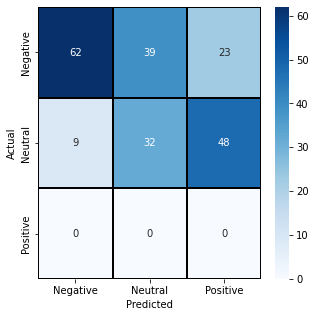

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
cm = confusion_matrix(predictions,y_test)
plt.figure(figsize = (5,5))
sns.heatmap(cm,cmap= "Blues", 
            linecolor = 'black', 
            linewidth = 1, 
            annot = True, 
            fmt='', 
            xticklabels = ['Negative','Neutral','Positive'], 
            yticklabels = ['Negative','Neutral','Positive'])
plt.xlabel("Predicted")
plt.ylabel("Actual")


#### grid search cv

In [ ]:
from sklearn.model_selection import cross_val_predict
from sklearn.model_selection import cross_val_score
#dctc= DecisionTreeClassifier()
cvs = cross_val_score(text_classifier,X,y,scoring='accuracy',cv=10)
print('cross_val =  ',cvs.mean())
print('cross',cvs.std())


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

cross_val =   0.6594367142148713
cross 0.020555982603295324


gridsearch

In [ ]:
from sklearn.model_selection import GridSearchCV

# defining parameter range
param_grid = {
              'max_depth':[3,4,5,6,7,8,9,10],
              'max_features':['auto'],
              'max_leaf_nodes':[1,2,3,4,5],
              'max_samples':[0.0,0.2,0.4,0.6,0.8,1],
              'min_samples_leaf':[1,2,3,4,5], 
              'min_samples_split':[2,3,4,5,6]}
 
grid = GridSearchCV(RandomForestClassifier(), param_grid, refit = True, verbose = 3)
 
# fitting the model for grid search
grid.fit(X_train, y_train)

Fitting 5 folds for each of 6000 candidates, totalling 30000 fits
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, ma

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samp

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samp

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_l

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.2s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.2s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.2s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.2s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.2s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.2s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.2s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.2s

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)



[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.2s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.2s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.2s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.2s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.2s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.2s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.2s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.2s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.2s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.2s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.2s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.2s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.2s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.2s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.2s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.2s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.2s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.2s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.2s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.2s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.2s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.2s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.2s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.2s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.2s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.2s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.2s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.2s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.2s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.2s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.2s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.2s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.2s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.2s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.2s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.2s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.2s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.2s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.2s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.2s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.2s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.2s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.2s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.2s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.2s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.2s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.2s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.2s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.2s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.2s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.2s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.2s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.2s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.2s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.2s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.383 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.2s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.2s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.2s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.2s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.2s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.2s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.2s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.2s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.2s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.2s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.2s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.2s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.2s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.2s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.2s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.2s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.2s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.2s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.2s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.2s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.2s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.2s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.2s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.383 total time=   0.2s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.2s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.2s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.2s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.2s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.2s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.2s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.2s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.2s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.2s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.2s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.2s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.383 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.2s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.2s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.2s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.2s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.2s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.2s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.2s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.2s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.2s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.383 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.2s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.2s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.383 total time=   0.2s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.2s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.2s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.2s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.2s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.2s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.2s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.2s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.2s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.2s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.2s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.2s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.2s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.2s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.2s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.2s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.2s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.2s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.2s

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)



[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.2s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.2s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.2s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.2s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.2s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.2s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.2s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.2s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.2s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.2s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.2s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.2s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.2s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.2s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.2s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.2s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.2s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.2s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.2s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.2s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.2s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.2s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.2s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.2s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.2s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.2s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.2s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.2s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.2s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.2s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.2s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.2s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.2s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.2s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.2s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.2s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.2s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.2s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.2s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.383 total time=   0.2s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.2s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.2s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.2s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.383 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.2s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.2s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.2s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.2s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.2s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.2s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.2s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.2s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.2s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.2s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.2s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.2s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.2s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.2s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.2s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.2s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.2s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.2s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.2s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.2s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.2s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.2s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.2s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.385 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.2s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.2s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.2s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.2s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.2s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.2s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.2s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.2s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.2s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.2s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.2s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.2s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.2s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.2s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.2s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.2s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.2s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.2s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.2s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.2s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.2s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.2s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.2s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.2s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.2s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.2s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.383 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.2s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.2s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.2s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.2s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.2s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.2s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.2s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.2s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.2s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.2s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.2s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.2s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.383 total time=   0.2s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.2s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.2s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.2s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.2s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.2s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.2s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.2s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.2s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.2s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.2s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.2s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.2s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.2s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.2s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.2s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.2s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.2s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.2s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.383 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.2s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.2s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.2s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.2s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.2s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.2s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.2s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.2s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.2s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.2s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.2s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.2s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.2s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.2s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.2s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.2s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.2s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.2s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.2s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.2s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.2s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.2s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.2s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.2s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.2s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.2s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.2s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.2s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.2s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.2s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.2s
[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.2s
[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.2s
[CV 1/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.2s
[CV 3/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.2s
[CV 5/5] END max_depth=3, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.2s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)



[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samp

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.383 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.2s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.6s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.385 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.383 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.383 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.383 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.573 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.572 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.383 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.385 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.383 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.383 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=4, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.385 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.383 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_l

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.383 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.385 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.383 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_l

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.383 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.383 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.385 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.383 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_l

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.573 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.383 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.383 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_l

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.385 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_l

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.383 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.383 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.385 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_l

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.6s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.383 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_l

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_l

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_l

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.383 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.383 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.385 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.383 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.385 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=6, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_l

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_l

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.383 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.383 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.385 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.383 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_l

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.385 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.6s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.383 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.385 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.383 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.6s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.383 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.383 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.383 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.383 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.383 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=8, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)



[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.383 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.383 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.383 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.383 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_l

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.383 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.7s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.383 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_l

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_le

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.573 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.573 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.573 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.383 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.383 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samp

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_sa

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_sam

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_sam

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_sam

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_sam

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_sa

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_sam

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=1, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.1s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_sam

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_sam

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_sam

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_sam

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_sam

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_sam

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_samples_leaf=5, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.0, min_sam

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.6s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.383 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.383 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.383 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.383 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.385 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=2, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_sam

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_sam

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_sam

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_sam

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_sam

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_sam

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_sam

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_sam

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.385 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.385 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.383 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.383 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.383 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=3, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_sam

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_sam

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=2, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_sam

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_sam

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_sam

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_sam

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_sam

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.0, min_samples_leaf=5, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.573 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.383 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.383 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.383 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=4, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_sam

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_sam

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=1, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_sam

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_sam

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=2, min_samples_split=6;, score=nan total time=   0.0s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=3, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_sam

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=3, min_samples_split=4;, score=nan total time=   0.0s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=3, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_sam

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=2;, score=nan total time=   0.0s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_sam

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=5;, score=nan total time=   0.0s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=4, min_samples_split=6;, score=nan total time=   0.0s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_sam

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=5, min_samples_split=3;, score=nan total time=   0.0s
[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_samples_leaf=5, min_samples_split=4;, score=nan total time=   0.0s
[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.0, min_sam

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 

[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.2, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.4, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.6, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=2;, score=0.570 total time=   0.5s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=0.8, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.383 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=1, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=4;, score=0.570 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=2, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=3, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=2;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=4, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=2;, score=0.385 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=3;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=4;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.571 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=5;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.383 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.571 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:680: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/5] END max_depth=10, max_features=auto, max_leaf_nodes=5, max_samples=1, min_samples_leaf=5, min_samples_split=6;, score=0.570 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:372: FitFailedWarning: 
10000 fits failed out of a total of 30000.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5000 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 680, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_forest.py", line 386, in fit
    n_samples=X.shape[0], max_samples=self.max_samples
  File "/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_forest.py", line 117, in _get_n_samples_bootstrap
    raise ValueError(msg.format(max_samples))


GridSearchCV(estimator=RandomForestClassifier(),
             param_grid={'max_depth': [3, 4, 5, 6, 7, 8, 9, 10],
                         'max_features': ['auto'],
                         'max_leaf_nodes': [1, 2, 3, 4, 5],
                         'max_samples': [0.0, 0.2, 0.4, 0.6, 0.8, 1],
                         'min_samples_leaf': [1, 2, 3, 4, 5],
                         'min_samples_split': [2, 3, 4, 5, 6]},
             verbose=3)

In [ ]:
# print best parameter after tuning
print(grid.best_params_)
 
# print how our model looks after hyper-parameter tuning
print(grid.best_estimator_)

{'max_depth': 4, 'max_features': 'auto', 'max_leaf_nodes': 5, 'max_samples': 0.6, 'min_samples_leaf': 2, 'min_samples_split': 2}
RandomForestClassifier(max_depth=4, max_leaf_nodes=5, max_samples=0.6,
                       min_samples_leaf=2)


In [ ]:
grid_predictions = grid.predict(X_test)
 
# print classification report
print(classification_report(y_test, grid_predictions))

              precision    recall  f1-score   support

          -1       0.33      1.00      0.50        71
           0       0.00      0.00      0.00        71
           1       0.00      0.00      0.00        71

    accuracy                           0.33       213
   macro avg       0.11      0.33      0.17       213
weighted avg       0.11      0.33      0.17       213



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Text(23.999999999999996, 0.5, 'Actual')

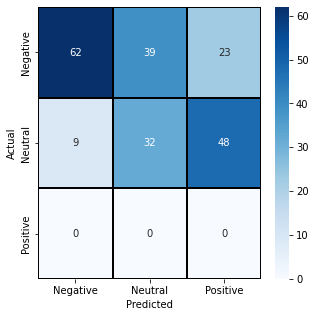

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
cm = confusion_matrix(predictions,y_test)
plt.figure(figsize = (5,5))
sns.heatmap(cm,cmap= "Blues", 
            linecolor = 'black', 
            linewidth = 1, 
            annot = True, 
            fmt='', 
            xticklabels = ['Negative','Neutral','Positive'], 
            yticklabels = ['Negative','Neutral','Positive'])
plt.xlabel("Predicted")
plt.ylabel("Actual")

ความแม่นยำโดยรวมของแบบจำลองในข้อมูลการทดสอบอยู่ที่ประมาณ 60% ซึ่งถือว่าค่อนข้างปานกลางเมื่อพิจารณาว่าเราไม่ได้ทำการแยกคุณลักษณะหรือประมวลผลล่วงหน้ามากนัก

###K-Nearest Neighbour


####Feature Scaling
Before making any actual predictions, it is always a good practice to scale the features so that all of them can be uniformly evaluated.

(Since the range of values of raw data varies widely, in some machine learning algorithms, objective functions will not work properly without normalization. For example, the majority of classifiers calculate the distance between two points by the Euclidean distance. If one of the features has a broad range of values, the distance will be governed by this particular feature. Therefore, the range of all features should be normalized so that each feature contributes approximately proportionately to the final distance.)
เนื่องจากช่วงของค่าของข้อมูลดิบนั้นแตกต่างกันอย่างมาก ในอัลกอริธึมการเรียนรู้ของเครื่องบางตัว ฟังก์ชันวัตถุประสงค์จะไม่ทำงานอย่างถูกต้องหากไม่มีการทำให้เป็นมาตรฐาน ตัวอย่างเช่น ตัวแยกประเภทส่วนใหญ่คำนวณระยะห่างระหว่างจุดสองจุดด้วยระยะทางแบบยุคลิด หากคุณลักษณะใดค่าหนึ่งมีค่าเป็นช่วงกว้าง ระยะทางจะเป็นไปตามคุณลักษณะเฉพาะนี้ ดังนั้น ช่วงของคุณสมบัติทั้งหมดควรถูกทำให้เป็นมาตรฐาน เพื่อให้แต่ละสถานที่มีส่วนสนับสนุนตามสัดส่วนโดยประมาณกับระยะทางสุดท้าย

The gradient descent algorithm (which is used in neural network training and other machine learning algorithms) also converges faster with normalized features.

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler(with_mean=False)
scaler.fit(X_train)

X_train = scaler.transform(X_train)
X_test = scaler.transform(X_test)




การฝึกอัลกอริทึม KNN และคาดการณ์ได้ตรงไปตรงมาอย่างยิ่ง โดยเฉพาะเมื่อใช้ Scikit-Learn

In [ ]:
from sklearn.neighbors import KNeighborsClassifier
#hyperparameter
#algorithm='auto', leaf_size=30, metric='minkowski',metric_params=None, n_jobs=None, n_neighbors=5, p=2,weights='uniform'
classifier = KNeighborsClassifier()
classifier.fit(X_train,y_train)

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


KNeighborsClassifier()

ขั้นตอนแรกคือการนำเข้าKNeighborsClassifierคลาสจากsklearn.neighborsไลบรารี n_neigboursในบรรทัดที่สองชั้นนี้จะเริ่มต้นได้ด้วยพารามิเตอร์หนึ่งคือ นี่คือค่าของ K โดยพื้นฐานแล้ว ไม่มีค่าในอุดมคติสำหรับ K และค่านี้จะถูกเลือกหลังจากการทดสอบและประเมินผล อย่างไรก็ตาม ในการเริ่มต้น ดูเหมือนว่า 5 จะเป็นค่าที่ใช้บ่อยที่สุดสำหรับอัลกอริทึม KNN

In [ ]:
y_pred = classifier.predict(X_test)


For evaluating an algorithm, confusion matrix, precision, recall and f1 score are the most commonly used metrics. The confusion_matrix and classification_report methods of the sklearn.metrics can be used to calculate these metrics. 

In [ ]:
from sklearn.metrics import classification_report, confusion_matrix
print(confusion_matrix(y_test, y_pred))
print(classification_report(y_test, y_pred))

[[40 31  0]
 [31 40  0]
 [38 33  0]]
              precision    recall  f1-score   support

          -1       0.37      0.56      0.44        71
           0       0.38      0.56      0.46        71
           1       0.00      0.00      0.00        71

    accuracy                           0.38       213
   macro avg       0.25      0.38      0.30       213
weighted avg       0.25      0.38      0.30       213



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


ความแม่นยำโดยรวมของแบบจำลองในข้อมูลการทดสอบอยู่ที่ประมาณ 27% ซึ่งถือว่าค่อนข้างแย่เมื่อพิจารณาว่าเราไม่ได้ทำการแยกคุณลักษณะหรือประมวลผลล่วงหน้ามากนัก

Text(23.999999999999996, 0.5, 'Actual')

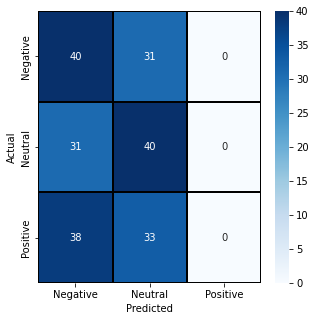

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
cm = confusion_matrix(y_test, y_pred)
plt.figure(figsize = (5,5))
sns.heatmap(cm,cmap= "Blues", 
            linecolor = 'black', 
            linewidth = 1, 
            annot = True, 
            fmt='', 
            xticklabels = ['Negative','Neutral','Positive'], 
            yticklabels = ['Negative','Neutral','Positive'])
plt.xlabel("Predicted")
plt.ylabel("Actual")


#### grid search cv

In [ ]:
from sklearn.model_selection import cross_val_predict
from sklearn.model_selection import cross_val_score
#dctc= DecisionTreeClassifier()
cvs=cross_val_score(classifier,X,y,scoring='accuracy',cv=10)
print('cross_val =  ',cvs.mean())


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

cross_val =   0.47574458154662935


gridsearch

In [ ]:

from sklearn.model_selection import GridSearchCV

# defining parameter range
param_grid = {'algorithm':['auto'],
              'n_neighbors':[5,6,7,8,9,10],
              'p':[2,3,4,5,6],
              'weights':['uniform','distance'],
              'leaf_size':[30,40,50,60,70,100],
              'metric':['minkowski'],
              'n_jobs':[-1,0.001,0.01,0.1,1]}
 
grid = GridSearchCV(KNeighborsClassifier(), param_grid, refit = True, verbose = 3)
 
# fitting the model for grid search
grid.fit(X_train, y_train)

Fitting 5 folds for each of 1800 candidates, totalling 9000 fits


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=5, p=2, weights=uniform;, score=0.529 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=5, p=2, weights=uniform;, score=0.505 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=5, p=2, weights=uniform;, score=0.488 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=5, p=2, weights=uniform;, score=0.476 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=5, p=2, weights=uniform;, score=0.481 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=5, p=2, weights=distance;, score=0.527 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=5, p=2, weights=distance;, score=0.509 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=5, p=2, weights=distance;, score=0.486 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=5, p=2, weights=distance;, score=0.474 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=5, p=2, weights=distance;, score=0.481 total time=   0.3s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=5, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=5, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=5, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=5, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=5, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=5, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=5, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=5, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=a

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=5, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=5, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=5, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=5, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=5, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=5, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=5, p=6, weights=distance;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=6, p=2, weights=uniform;, score=0.527 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=6, p=2, weights=uniform;, score=0.520 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=6, p=2, weights=uniform;, score=0.502 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=6, p=2, weights=uniform;, score=0.488 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=6, p=2, weights=uniform;, score=0.495 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=6, p=2, weights=distance;, score=0.526 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=6, p=2, weights=distance;, score=0.501 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=6, p=2, weights=distance;, score=0.498 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=6, p=2, weights=distance;, score=0.491 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=6, p=2, weights=distance;, score=0.476 total time=   0.3s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=6, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=6, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=6, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=6, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=6, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=6, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=6, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=6, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=a

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=6, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=6, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=6, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=6, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=6, p=6, weights=distance;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=7, p=2, weights=uniform;, score=0.484 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=7, p=2, weights=uniform;, score=0.475 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=7, p=2, weights=uniform;, score=0.476 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=7, p=2, weights=uniform;, score=0.460 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=7, p=2, weights=uniform;, score=0.453 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=7, p=2, weights=distance;, score=0.489 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=7, p=2, weights=distance;, score=0.486 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=7, p=2, weights=distance;, score=0.480 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=7, p=2, weights=distance;, score=0.455 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=7, p=2, weights=distance;, score=0.452 total time=   0.3s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=7, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=7, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=7, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=7, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=7, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=a

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=7, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=7, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=7, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=7, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=7, p=6, weights=distance;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=8, p=2, weights=uniform;, score=0.505 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=8, p=2, weights=uniform;, score=0.496 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=8, p=2, weights=uniform;, score=0.482 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=8, p=2, weights=uniform;, score=0.457 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=8, p=2, weights=uniform;, score=0.470 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=8, p=2, weights=distance;, score=0.496 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=8, p=2, weights=distance;, score=0.496 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=8, p=2, weights=distance;, score=0.486 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=8, p=2, weights=distance;, score=0.458 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=8, p=2, weights=distance;, score=0.463 total time=   0.3s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=8, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam


[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=8, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=8, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=8, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=8, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=8, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=8, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=8, p=6, weights=distance;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=9, p=2, weights=uniform;, score=0.471 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=9, p=2, weights=uniform;, score=0.477 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=9, p=2, weights=uniform;, score=0.447 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=9, p=2, weights=uniform;, score=0.442 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=9, p=2, weights=uniform;, score=0.447 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=9, p=2, weights=distance;, score=0.473 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=9, p=2, weights=distance;, score=0.486 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=9, p=2, weights=distance;, score=0.444 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=9, p=2, weights=distance;, score=0.440 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=9, p=2, weights=distance;, score=0.444 total time=   0.3s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=9, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=a

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=9, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=9, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=10, p=2, weights=uniform;, score=0.488 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=10, p=2, weights=uniform;, score=0.479 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=10, p=2, weights=uniform;, score=0.463 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=10, p=2, weights=uniform;, score=0.453 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=10, p=2, weights=uniform;, score=0.454 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=10, p=2, weights=distance;, score=0.484 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=10, p=2, weights=distance;, score=0.475 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=10, p=2, weights=distance;, score=0.454 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=10, p=2, weights=distance;, score=0.451 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=10, p=2, weights=distance;, score=0.441 total time=   0.4s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=10, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END alg

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=10, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END al

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=10, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=10, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=10, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=10, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=-1, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algo

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=2, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=2, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=2, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=4, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=4, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=5, weights=uniform;, score=nan total time=   0.0s
[

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=6, weights=distance;, score=nan total time=   0.0s
[C

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_scorer.py", line 418, in _passthrough_scorer
    return estimator.score(*args, **kwargs)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/base.py", line 651, in score
    return accuracy_score(y, self

[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=2, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=2, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=2, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=4, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=4, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=5, weights=uniform;, score=nan total time=   0.0s
[

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=6, weights=distance;, score=nan total time=   0.0s
[C

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_scorer.py", line 418, in _passthrough_scorer
    return estimator.score(*args, **kwargs)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/base.py", line 651, in score
    return accuracy_score(y, self

[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=2, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=2, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=5, weights=uniform;, score=nan total time=   0.0s
[C

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam


[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=6, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=2, weights=uniform;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=3, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=3, weights=distance;, score=nan total time=   0.0s
[CV

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=5, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=5, weights=distance;, score=nan total time=   0.0s
[CV 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During 

[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=6, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=2, weights=distance;, score=nan total time=   0.0s
[CV 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=3, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=3, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=3, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=4, weights=uniform;, score=nan total time=   0.0s
[CV

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=5, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=5, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=5, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=5, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=5, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=6, weights=uniform;, score=nan total time=   0.0s
[

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_scorer.py", line 418, in _passthrough_scorer
    return estimator.score(*args, **kwargs)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/base.py", line 651, in score
    return accuracy_score(y, self

[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=2, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=2, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=2, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=2, weights=distance;, score=nan total time=   

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=5, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=5, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=5, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=5, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=6, weights=uniform;, score=nan total time=   

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=2, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=2, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=2, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=2, weights=distance;, score=nan total time=   0.0s
[CV 5/5] 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/

[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=3, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=4, weights=distance;, score=nan total time=   0.0s
[CV 2/5] EN

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=5, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=5, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=5, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=5, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=2, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=2, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=2, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=2, weights=distance;, score=nan total time=   0.0s
[CV 5/5] 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/


[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=3, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=4, weights=distance;, score=nan total time=   0.0s
[CV 2/5] E

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=5, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=5, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=5, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=5, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=2, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=2, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=2, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=2, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=2, weights=distance;, score=nan total time=   0.0s
[CV 1/5]

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/


[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 3/5] E

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=5, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=5, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=5, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=5, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=2, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=2, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=2, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=2, weights=distance;, score=nan total time=   0.0s
[CV 5/5] 

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_scorer.py", line 418, in _passthrough_scorer
    return estimator.score(*args, **kwargs)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/base.py", line 651, in score
    return accuracy_score(y, self

[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=3, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=3, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] EN

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=5, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=5, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=5, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=5, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=2, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=2, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=2, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=2, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=2, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5]

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/

[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] E

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=5, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=5, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=5, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] E

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=2, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=2, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=2, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=2, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=2, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_scorer.py", line 418, in _passthrough_scorer
    return estimator.score(*args, **kwargs)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/base.py", line 651, in score
    return accuracy_score(y, self

[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[C

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s
[CV 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=2, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=2, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=2, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=2, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=2, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END al

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/


[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=4, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=4, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END al

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=5, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=5, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algor

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=2, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=2, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=2, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=2, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=2, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END al

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/

[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=4, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=4, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algo

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=5, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=5, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algor

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=2, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=2, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=2, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=2, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=2, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END al

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/

[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algo

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=5, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algor

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=2, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=2, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=2, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=2, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END alg

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/

[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END al

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algo

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=2, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=2, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=2, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=2, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END alg

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam


[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END al

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=2, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=2, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] EN

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] E

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=5, p=2, weights=uniform;, score=0.529 total time=   0.2s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=5, p=2, weights=uniform;, score=0.505 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=5, p=2, weights=uniform;, score=0.488 total time=   0.2s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=5, p=2, weights=uniform;, score=0.476 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=5, p=2, weights=uniform;, score=0.481 total time=   0.2s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=5, p=2, weights=distance;, score=0.527 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=5, p=2, weights=distance;, score=0.509 total time=   0.1s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=5, p=2, weights=distance;, score=0.486 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=5, p=2, weights=distance;, score=0.474 total time=   0.2s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=5, p=2, weights=distance;, score=0.481 total time=   0.1s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=5, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=5, p=3, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=5, p=3, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=5, p=3, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=5, p=3, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=5, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=5, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=5, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=5, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=5, p=5, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=5, p=5, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=5, p=5, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=5, p=5, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, l

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=6, p=2, weights=uniform;, score=0.527 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=6, p=2, weights=uniform;, score=0.520 total time=   0.2s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=6, p=2, weights=uniform;, score=0.502 total time=   0.2s

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)



[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=6, p=2, weights=uniform;, score=0.488 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=6, p=2, weights=uniform;, score=0.495 total time=   0.2s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=6, p=2, weights=distance;, score=0.526 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=6, p=2, weights=distance;, score=0.501 total time=   0.2s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=6, p=2, weights=distance;, score=0.498 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=6, p=2, weights=distance;, score=0.491 total time=   0.2s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=6, p=2, weights=distance;, score=0.476 total time=   0.1s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=6, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=6, p=3, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=6, p=3, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=6, p=3, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=6, p=3, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=6, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=6, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=6, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=6, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=6, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=6, p=5, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=6, p=5, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=6, p=5, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, le

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=6, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=6, p=6, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=7, p=2, weights=uniform;, score=0.484 total time=   0.2s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=7, p=2, weights=uniform;, score=0.475 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=7, p=2, weights=uniform;, score=0.476 total time=   0.2s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=7, p=2, weights=uniform;, score=0.460 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=7, p=2, weights=uniform;, score=0.453 total time=   0.2s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=7, p=2, weights=distance;, score=0.489 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=7, p=2, weights=distance;, score=0.486 total time=   0.2s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=7, p=2, weights=distance;, score=0.480 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=7, p=2, weights=distance;, score=0.455 total time=   0.2s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=7, p=2, weights=distance;, score=0.452 total time=   0.1s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=7, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=7, p=3, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=7, p=3, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=7, p=3, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=7, p=3, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=7, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=7, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=7, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=7, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=7, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, le

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=7, p=5, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=7, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, lea

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=8, p=2, weights=uniform;, score=0.505 total time=   0.2s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=8, p=2, weights=uniform;, score=0.496 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=8, p=2, weights=uniform;, score=0.482 total time=   0.2s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=8, p=2, weights=uniform;, score=0.457 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=8, p=2, weights=uniform;, score=0.470 total time=   0.2s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=8, p=2, weights=distance;, score=0.496 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=8, p=2, weights=distance;, score=0.496 total time=   0.1s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=8, p=2, weights=distance;, score=0.486 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=8, p=2, weights=distance;, score=0.458 total time=   0.1s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=8, p=2, weights=distance;, score=0.463 total time=   0.1s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=8, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=8, p=3, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=8, p=3, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=8, p=3, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=8, p=3, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=8, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=8, p=5, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=8, p=5, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=8, p=5, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=8, p=5, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, l

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=9, p=2, weights=uniform;, score=0.471 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=9, p=2, weights=uniform;, score=0.477 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=9, p=2, weights=uniform;, score=0.447 total time=   0.2s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=9, p=2, weights=uniform;, score=0.442 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=9, p=2, weights=uniform;, score=0.447 total time=   0.2s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=9, p=2, weights=distance;, score=0.473 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=9, p=2, weights=distance;, score=0.486 total time=   0.2s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=9, p=2, weights=distance;, score=0.444 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=9, p=2, weights=distance;, score=0.440 total time=   0.2s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=9, p=2, weights=distance;, score=0.444 total time=   0.2s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=9, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=9, p=3, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=9, p=3, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=9, p=3, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=9, p=3, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=9, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=9, p=5, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=9, p=5, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=9, p=5, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=9, p=5, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, l

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=10, p=2, weights=uniform;, score=0.488 total time=   0.2s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=10, p=2, weights=uniform;, score=0.479 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=10, p=2, weights=uniform;, score=0.463 total time=   0.2s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=10, p=2, weights=uniform;, score=0.453 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=10, p=2, weights=uniform;, score=0.454 total time=   0.2s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=10, p=2, weights=distance;, score=0.484 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=10, p=2, weights=distance;, score=0.475 total time=   0.2s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=10, p=2, weights=distance;, score=0.454 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=10, p=2, weights=distance;, score=0.451 total time=   0.2s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=10, p=2, weights=distance;, score=0.441 total time=   0.1s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=10, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=10, p=3, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=10, p=3, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=10, p=3, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=10, p=3, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=10, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=10, p=5, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=10, p=5, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=10, p=5, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=30, metric=minkowski, n_jobs=1, n_neighbors=10, p=5, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=5, p=2, weights=uniform;, score=0.529 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=5, p=2, weights=uniform;, score=0.505 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=5, p=2, weights=uniform;, score=0.488 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=5, p=2, weights=uniform;, score=0.476 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=5, p=2, weights=uniform;, score=0.481 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=5, p=2, weights=distance;, score=0.527 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=5, p=2, weights=distance;, score=0.509 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=5, p=2, weights=distance;, score=0.486 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=5, p=2, weights=distance;, score=0.474 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=5, p=2, weights=distance;, score=0.481 total time=   0.3s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=5, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=5, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=5, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=5, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=5, p=4, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=5, p=4, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=5, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=5, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=5, p=5, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=5, p=5, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=5, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=5, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=5, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=5, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=5, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=au

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=6, p=2, weights=uniform;, score=0.527 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=6, p=2, weights=uniform;, score=0.520 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=6, p=2, weights=uniform;, score=0.502 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=6, p=2, weights=uniform;, score=0.488 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=6, p=2, weights=uniform;, score=0.495 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=6, p=2, weights=distance;, score=0.526 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=6, p=2, weights=distance;, score=0.501 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=6, p=2, weights=distance;, score=0.498 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=6, p=2, weights=distance;, score=0.491 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=6, p=2, weights=distance;, score=0.476 total time=   0.3s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=6, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=6, p=4, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=6, p=4, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=6, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=6, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=6, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=6, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=6, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=6, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=6, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=6, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=6, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=6, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=6, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=6, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=au

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=7, p=2, weights=uniform;, score=0.484 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=7, p=2, weights=uniform;, score=0.475 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=7, p=2, weights=uniform;, score=0.476 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=7, p=2, weights=uniform;, score=0.460 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=7, p=2, weights=uniform;, score=0.453 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=7, p=2, weights=distance;, score=0.489 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=7, p=2, weights=distance;, score=0.486 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=7, p=2, weights=distance;, score=0.480 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=7, p=2, weights=distance;, score=0.455 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=7, p=2, weights=distance;, score=0.452 total time=   0.4s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=7, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=7, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=7, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=7, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=7, p=5, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=7, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=au

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=8, p=2, weights=uniform;, score=0.505 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=8, p=2, weights=uniform;, score=0.496 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=8, p=2, weights=uniform;, score=0.482 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=8, p=2, weights=uniform;, score=0.457 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=8, p=2, weights=uniform;, score=0.470 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=8, p=2, weights=distance;, score=0.496 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=8, p=2, weights=distance;, score=0.496 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=8, p=2, weights=distance;, score=0.486 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=8, p=2, weights=distance;, score=0.458 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=8, p=2, weights=distance;, score=0.463 total time=   0.3s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=8, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=8, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=8, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=8, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=8, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=8, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=8, p=6, weights=distance;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=9, p=2, weights=uniform;, score=0.471 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=9, p=2, weights=uniform;, score=0.477 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=9, p=2, weights=uniform;, score=0.447 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=9, p=2, weights=uniform;, score=0.442 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=9, p=2, weights=uniform;, score=0.447 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=9, p=2, weights=distance;, score=0.473 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=9, p=2, weights=distance;, score=0.486 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=9, p=2, weights=distance;, score=0.444 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=9, p=2, weights=distance;, score=0.440 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=9, p=2, weights=distance;, score=0.444 total time=   0.3s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=9, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=a

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=9, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=10, p=2, weights=uniform;, score=0.488 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=10, p=2, weights=uniform;, score=0.479 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=10, p=2, weights=uniform;, score=0.463 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=10, p=2, weights=uniform;, score=0.453 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=10, p=2, weights=uniform;, score=0.454 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=10, p=2, weights=distance;, score=0.484 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=10, p=2, weights=distance;, score=0.475 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=10, p=2, weights=distance;, score=0.454 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=10, p=2, weights=distance;, score=0.451 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=10, p=2, weights=distance;, score=0.441 total time=   0.3s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=10, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END alg

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algo

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=-1, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] EN

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=3, weights=distance;, score=nan total time=   0.0s
[CV 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=5, weights=uniform;, score=nan total time=   0.0s
[CV

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam


[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=6, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=2, weights=uniform;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=3, weights=distance;, score=nan total time=   0.0s
[CV 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=6, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=2, weights=uniform;, score=nan total time=   0.0s
[C

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=3, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=3, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=3, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=3, weights=distance;, score=nan total time=   0.0s
[

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=6, weights=distance;, score=nan total time=   0.0s
[CV

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_scorer.py", line 418, in _passthrough_scorer
    return estimator.score(*args, **kwargs)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/base.py", line 651, in score
    return accuracy_score(y, self

[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=2, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=2, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=2, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=2, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=2, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=3, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=5, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=5, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=5, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=5, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=5, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=6, weights=uniform;, score=nan total time=   0.0s
[

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During 

[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=2, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=2, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=2, weights=distance;, score=nan total time=   0.0s
[CV

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=3, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=3, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=3, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=4, weights=uniform;, score=nan total time=   0.0s
[CV

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=5, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=5, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=5, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=5, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=5, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=6, weights=uniform;, score=nan total time=   0.0s
[

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_scorer.py", line 418, in _passthrough_scorer
    return estimator.score(*args, **kwargs)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/base.py", line 651, in score
    return accuracy_score(y, self

[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=2, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=2, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=2, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=2, weights=distance;, score=nan total time=   

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=3, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=3, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=3, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=4, weights=uniform;, score=nan total time=   0

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=5, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=5, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=5, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=5, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=5, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=6, weights=uniform;, score=nan total time=  

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/

[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=2, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=2, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=2, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=2, weights=distance;, score=nan total time=   0.0s
[CV 5/5] 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=3, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=3, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] EN

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=5, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=5, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=5, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=5, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] 

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_scorer.py", line 418, in _passthrough_scorer
    return estimator.score(*args, **kwargs)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/base.py", line 651, in score
    return accuracy_score(y, self

[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=2, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=2, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=2, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=2, weights=distance;, score=nan total time=   0.0s
[CV 5/5] 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=3, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=4, weights=distance;, score=nan total time=   0.0s
[CV 2/5] EN

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=5, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=5, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=5, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=5, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/

[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=2, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=2, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=2, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=2, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=2, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5]

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=5, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=5, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=5, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] E

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/

[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=2, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=2, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=2, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=2, weights=distance;, score=nan total time=   0.0s
[CV 5/5] 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=3, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=3, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=3, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=3, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=5, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=5, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=5, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=5, weights=distance;, score=nan total time=   0.0s
[CV 5/5] 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=6, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] E

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_scorer.py", line 418, in _passthrough_scorer
    return estimator.score(*args, **kwargs)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/base.py", line 651, in score
    return accuracy_score(y, self

[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=3, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=3, weights=distance;, score=nan total time=   0.0s
[CV 4/5] E

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=5, weights=distance;, score=nan total time=   0.0s
[CV 2/5] EN

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 5/

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=3, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=3, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=3, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=3, weights=distance;, score=nan total time=   0.0s
[

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=5, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=5, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=5, weights=distance;, score=nan total time=   0.0s
[CV

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam


[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=2, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END al

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=3, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=3, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=3, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=3, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END al

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=5, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=5, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=5, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=5, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END alg

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=2, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=2, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algor

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=3, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=3, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=3, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=3, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END al

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=5, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=5, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=5, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=5, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=5, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END al

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=2, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=2, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algor

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=3, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=3, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=3, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algo

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=5, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=5, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=5, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=5, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=5, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END al

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most

[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=2, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=2, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=2, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=2, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END alg

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=3, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algor

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=5, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=5, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=5, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=5, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END alg

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/

[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=2, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=2, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=2, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=2, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=2, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END al

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algo

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=5, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=5, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=5, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algo

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/


[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=2, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=2, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=2, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=2, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=2, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] E

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=5, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] EN

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=5, p=2, weights=uniform;, score=0.488 total time=   0.2s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=5, p=2, weights=uniform;, score=0.476 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=5, p=2, weights=uniform;, score=0.481 total time=   0.2s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=5, p=2, weights=distance;, score=0.527 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=5, p=2, weights=distance;, score=0.509 total time=   0.2s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=5, p=2, weights=distance;, score=0.486 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=5, p=2, weights=distance;, score=0.474 total time=   0.2s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=5, p=2, weights=distance;, score=0.481 total time=   0.1s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=5, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=5, p=3, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=5, p=3, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=5, p=3, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=5, p=3, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=5, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=5, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=5, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=5, p=5, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=5, p=5, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=5, p=5, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=5, p=5, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=5, p=5, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=5, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=6, p=2, weights=uniform;, score=0.502 total time=   0.2s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=6, p=2, weights=uniform;, score=0.488 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=6, p=2, weights=uniform;, score=0.495 total time=   0.2s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=6, p=2, weights=distance;, score=0.526 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=6, p=2, weights=distance;, score=0.501 total time=   0.1s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=6, p=2, weights=distance;, score=0.498 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=6, p=2, weights=distance;, score=0.491 total time=   0.2s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=6, p=2, weights=distance;, score=0.476 total time=   0.1s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=6, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=6, p=3, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=6, p=3, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=6, p=3, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=6, p=3, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=6, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=6, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=6, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=6, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=6, p=5, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=6, p=5, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=6, p=5, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=6, p=5, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, l

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=7, p=2, weights=uniform;, score=0.484 total time=   0.2s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=7, p=2, weights=uniform;, score=0.475 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=7, p=2, weights=uniform;, score=0.476 total time=   0.2s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=7, p=2, weights=uniform;, score=0.460 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=7, p=2, weights=uniform;, score=0.453 total time=   0.2s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=7, p=2, weights=distance;, score=0.489 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=7, p=2, weights=distance;, score=0.486 total time=   0.2s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=7, p=2, weights=distance;, score=0.480 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=7, p=2, weights=distance;, score=0.455 total time=   0.2s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=7, p=2, weights=distance;, score=0.452 total time=   0.2s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam


[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=7, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=7, p=3, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=7, p=3, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=7, p=3, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=7, p=3, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=7, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto,

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=7, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=7, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=7, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=7, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=7, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=7, p=5, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=7, p=5, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, lea

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=7, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=7, p=6, weights=distance;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=8, p=2, weights=uniform;, score=0.505 total time=   0.2s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=8, p=2, weights=uniform;, score=0.496 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=8, p=2, weights=uniform;, score=0.482 total time=   0.2s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=8, p=2, weights=uniform;, score=0.457 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=8, p=2, weights=uniform;, score=0.470 total time=   0.2s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=8, p=2, weights=distance;, score=0.496 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=8, p=2, weights=distance;, score=0.496 total time=   0.2s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=8, p=2, weights=distance;, score=0.486 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=8, p=2, weights=distance;, score=0.458 total time=   0.2s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=8, p=2, weights=distance;, score=0.463 total time=   0.2s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=8, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=8, p=3, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=8, p=3, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=8, p=3, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=8, p=3, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, lea

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=8, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=8, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=8, p=6, weights=distance;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=9, p=2, weights=uniform;, score=0.471 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=9, p=2, weights=uniform;, score=0.477 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=9, p=2, weights=uniform;, score=0.447 total time=   0.2s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=9, p=2, weights=uniform;, score=0.442 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=9, p=2, weights=uniform;, score=0.447 total time=   0.2s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=9, p=2, weights=distance;, score=0.473 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=9, p=2, weights=distance;, score=0.486 total time=   0.2s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=9, p=2, weights=distance;, score=0.444 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=9, p=2, weights=distance;, score=0.440 total time=   0.2s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=9, p=2, weights=distance;, score=0.444 total time=   0.2s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=9, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=9, p=3, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=9, p=3, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=9, p=3, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=9, p=3, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=9, p=5, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=9, p=5, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=9, p=5, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, le

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=10, p=2, weights=uniform;, score=0.488 total time=   0.2s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=10, p=2, weights=uniform;, score=0.479 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=10, p=2, weights=uniform;, score=0.463 total time=   0.2s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=10, p=2, weights=uniform;, score=0.453 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=10, p=2, weights=uniform;, score=0.454 total time=   0.2s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=10, p=2, weights=distance;, score=0.484 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=10, p=2, weights=distance;, score=0.475 total time=   0.1s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=10, p=2, weights=distance;, score=0.454 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=10, p=2, weights=distance;, score=0.451 total time=   0.2s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=10, p=2, weights=distance;, score=0.441 total time=   0.2s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=10, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=10, p=3, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=10, p=3, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=10, p=3, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=au

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=40, metric=minkowski, n_jobs=1, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=5, p=2, weights=uniform;, score=0.529 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=5, p=2, weights=uniform;, score=0.505 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=5, p=2, weights=uniform;, score=0.488 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=5, p=2, weights=uniform;, score=0.476 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=5, p=2, weights=uniform;, score=0.481 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=5, p=2, weights=distance;, score=0.527 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=5, p=2, weights=distance;, score=0.509 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=5, p=2, weights=distance;, score=0.486 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=5, p=2, weights=distance;, score=0.474 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=5, p=2, weights=distance;, score=0.481 total time=   0.3s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=5, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=5, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=5, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=5, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=5, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=5, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=5, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=5, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=a

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=6, p=2, weights=uniform;, score=0.527 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=6, p=2, weights=uniform;, score=0.520 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=6, p=2, weights=uniform;, score=0.502 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=6, p=2, weights=uniform;, score=0.488 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=6, p=2, weights=uniform;, score=0.495 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=6, p=2, weights=distance;, score=0.526 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=6, p=2, weights=distance;, score=0.501 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=6, p=2, weights=distance;, score=0.498 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=6, p=2, weights=distance;, score=0.491 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=6, p=2, weights=distance;, score=0.476 total time=   0.3s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=6, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=6, p=4, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=6, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=6, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=6, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=6, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=6, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=6, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=6, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=6, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=6, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=6, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=6, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=6, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=6, p=6, weights=distance;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=7, p=2, weights=uniform;, score=0.484 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=7, p=2, weights=uniform;, score=0.475 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=7, p=2, weights=uniform;, score=0.476 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=7, p=2, weights=uniform;, score=0.460 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=7, p=2, weights=uniform;, score=0.453 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=7, p=2, weights=distance;, score=0.489 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=7, p=2, weights=distance;, score=0.486 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=7, p=2, weights=distance;, score=0.480 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=7, p=2, weights=distance;, score=0.455 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=7, p=2, weights=distance;, score=0.452 total time=   0.3s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=7, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=7, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=7, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=7, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=7, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=7, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=7, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=7, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=7, p=6, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=8, p=2, weights=uniform;, score=0.505 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=8, p=2, weights=uniform;, score=0.496 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=8, p=2, weights=uniform;, score=0.482 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=8, p=2, weights=uniform;, score=0.457 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=8, p=2, weights=uniform;, score=0.470 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=8, p=2, weights=distance;, score=0.496 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=8, p=2, weights=distance;, score=0.496 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=8, p=2, weights=distance;, score=0.486 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=8, p=2, weights=distance;, score=0.458 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=8, p=2, weights=distance;, score=0.463 total time=   0.3s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=8, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=8, p=5, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=8, p=5, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=8, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=8, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=8, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=8, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=8, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=au

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=9, p=2, weights=uniform;, score=0.471 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=9, p=2, weights=uniform;, score=0.477 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=9, p=2, weights=uniform;, score=0.447 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=9, p=2, weights=uniform;, score=0.442 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=9, p=2, weights=uniform;, score=0.447 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=9, p=2, weights=distance;, score=0.473 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=9, p=2, weights=distance;, score=0.486 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=9, p=2, weights=distance;, score=0.444 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=9, p=2, weights=distance;, score=0.440 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=9, p=2, weights=distance;, score=0.444 total time=   0.3s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=9, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=9, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=9, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=9, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=9, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=a

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=9, p=5, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=9, p=5, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=9, p=5, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=9, p=5, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=9, p=5, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=9, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=10, p=2, weights=uniform;, score=0.488 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=10, p=2, weights=uniform;, score=0.479 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=10, p=2, weights=uniform;, score=0.463 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=10, p=2, weights=uniform;, score=0.453 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=10, p=2, weights=uniform;, score=0.454 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=10, p=2, weights=distance;, score=0.484 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=10, p=2, weights=distance;, score=0.475 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=10, p=2, weights=distance;, score=0.454 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=10, p=2, weights=distance;, score=0.451 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=10, p=2, weights=distance;, score=0.441 total time=   0.4s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=10, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END alg

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algo

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=10, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=10, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=-1, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END al

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/

[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=2, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=3, weights=distance;, score=nan total time=   0.0s
[CV 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=5, weights=uniform;, score=nan total time=   0.0s
[CV

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=6, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=2, weights=uniform;, score=nan total time=   0.0s
[

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_scorer.py", line 418, in _passthrough_scorer
    return estimator.score(*args, **kwargs)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/base.py", line 651, in score
    return accuracy_score(y, self

[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=2, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=3, weights=distance;, score=nan total time=   0.0s
[CV 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=4, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=5, weights=uniform;, score=nan total time=   0.0s
[C

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=6, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=2, weights=uniform;, score=nan total time=   0.0s
[

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=6, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=2, weights=uniform;, score=nan total time=   0.0s
[

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=3, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=3, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=3, weights=distance;, score=nan total time=   0.0s
[C

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[C

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=2, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=2, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=2, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=2, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[C

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[C

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_scorer.py", line 418, in _passthrough_scorer
    return estimator.score(*args, **kwargs)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/base.py", line 651, in score
    return accuracy_score(y, self

[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=2, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=2, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=2, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=2, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=4, weights=distance;, score=nan total time=   

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=5, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_scorer.py", line 418, in _passthrough_scorer
    return estimator.score(*args, **kwargs)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/base.py", line 651, in score
    return accuracy_score(y, self

[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=2, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=2, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=2, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=2, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=2, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5]

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=4, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=4, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] EN

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_scorer.py", line 418, in _passthrough_scorer
    return estimator.score(*args, **kwargs)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/base.py", line 651, in score
    return accuracy_score(y, self

[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=2, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=2, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=2, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=2, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] EN

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=2, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=2, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=2, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] E

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5]

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=6, weights=distance;, score=nan total time=   0.0s
[CV 1/5]

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_scorer.py", line 418, in _passthrough_scorer
    return estimator.score(*args, **kwargs)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/base.py", line 651, in score
    return accuracy_score(y, self

[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=2, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] EN

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] EN

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=6, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=3, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=3, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=3, weights=distance;, score=nan total time=   0.0s
[CV 5/5] 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=5, weights=distance;, score=nan total time=   0.0s
[CV 2/5] EN

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 5/

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=3, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=3, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=3, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=3, weights=distance;, score=nan total time=   0.0s
[

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=5, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=5, weights=distance;, score=nan total time=   0.0s
[CV 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most

[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END a

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=3, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=3, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=3, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=3, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END al

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=5, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=5, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=5, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=5, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END alg

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_scorer.py", line 418, in _passthrough_scorer
    return estimator.score(*args, **kwargs)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/base.py", line 651, in score
    return accuracy_score(y, self

[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=2, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=2, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algor

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=3, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=3, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=3, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algo

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=5, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=5, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=5, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=5, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=5, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END al

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/

[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=2, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=2, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=2, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=2, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END alg

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algor

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=5, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=5, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=5, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algo

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/

[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=2, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=2, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=2, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=2, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=2, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END al

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END alg

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algor

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_scorer.py", line 418, in _passthrough_scorer
    return estimator.score(*args, **kwargs)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/base.py", line 651, in score
    return accuracy_score(y, self

[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=2, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=2, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algor

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END alg

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END a

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_scorer.py", line 418, in _passthrough_scorer
    return estimator.score(*args, **kwargs)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/base.py", line 651, in score
    return accuracy_score(y, self

[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=3, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=3, weights=distance;, score=nan total time=   0.0s
[CV 4/5] E

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam


[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] E

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=5, p=2, weights=uniform;, score=0.529 total time=   0.2s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=5, p=2, weights=uniform;, score=0.505 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=5, p=2, weights=uniform;, score=0.488 total time=   0.2s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=5, p=2, weights=uniform;, score=0.476 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=5, p=2, weights=uniform;, score=0.481 total time=   0.2s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=5, p=2, weights=distance;, score=0.527 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=5, p=2, weights=distance;, score=0.509 total time=   0.1s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=5, p=2, weights=distance;, score=0.486 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=5, p=2, weights=distance;, score=0.474 total time=   0.1s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=5, p=2, weights=distance;, score=0.481 total time=   0.1s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=5, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=5, p=3, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=5, p=3, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=5, p=3, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=5, p=3, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=5, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=5, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=5, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=5, p=5, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=5, p=5, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=5, p=5, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=5, p=5, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=5, p=5, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=5, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=5, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=5, p=6, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=6, p=2, weights=uniform;, score=0.527 total time=   0.3s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=6, p=2, weights=uniform;, score=0.520 total time=   0.2s

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=6, p=2, weights=uniform;, score=0.502 total time=   0.2s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=6, p=2, weights=uniform;, score=0.488 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=6, p=2, weights=uniform;, score=0.495 total time=   0.2s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=6, p=2, weights=distance;, score=0.526 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=6, p=2, weights=distance;, score=0.501 total time=   0.2s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=6, p=2, weights=distance;, score=0.498 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=6, p=2, weights=distance;, score=0.491 total time=   0.2s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=6, p=2, weights=distance;, score=0.476 total time=   0.2s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=6, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=6, p=3, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=6, p=3, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=6, p=3, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=6, p=3, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=6, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=6, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=6, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=6, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=6, p=5, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=6, p=5, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=6, p=5, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=6, p=5, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, l

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=7, p=2, weights=uniform;, score=0.484 total time=   0.2s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=7, p=2, weights=uniform;, score=0.475 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=7, p=2, weights=uniform;, score=0.476 total time=   0.2s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=7, p=2, weights=uniform;, score=0.460 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=7, p=2, weights=uniform;, score=0.453 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=7, p=2, weights=distance;, score=0.489 total time=   0.2s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=7, p=2, weights=distance;, score=0.486 total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=7, p=2, weights=distance;, score=0.480 total time=   0.2s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=7, p=2, weights=distance;, score=0.455 total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=7, p=2, weights=distance;, score=0.452 total time=   0.2s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=7, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, l

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=7, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=7, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=7, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=7, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, le

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=7, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=7, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=7, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=7, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=7, p=6, weights=distance;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=8, p=2, weights=uniform;, score=0.505 total time=   0.2s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=8, p=2, weights=uniform;, score=0.496 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=8, p=2, weights=uniform;, score=0.482 total time=   0.2s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=8, p=2, weights=uniform;, score=0.457 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=8, p=2, weights=uniform;, score=0.470 total time=   0.2s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=8, p=2, weights=distance;, score=0.496 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=8, p=2, weights=distance;, score=0.496 total time=   0.2s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=8, p=2, weights=distance;, score=0.486 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=8, p=2, weights=distance;, score=0.458 total time=   0.2s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=8, p=2, weights=distance;, score=0.463 total time=   0.1s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=8, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=8, p=3, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=8, p=3, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=8, p=3, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=8, p=3, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=8, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=8, p=5, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=8, p=5, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=8, p=5, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, le

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=9, p=2, weights=uniform;, score=0.471 total time=   0.2s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=9, p=2, weights=uniform;, score=0.477 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=9, p=2, weights=uniform;, score=0.447 total time=   0.2s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=9, p=2, weights=uniform;, score=0.442 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=9, p=2, weights=uniform;, score=0.447 total time=   0.2s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=9, p=2, weights=distance;, score=0.473 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=9, p=2, weights=distance;, score=0.486 total time=   0.1s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=9, p=2, weights=distance;, score=0.444 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=9, p=2, weights=distance;, score=0.440 total time=   0.2s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=9, p=2, weights=distance;, score=0.444 total time=   0.2s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=9, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=9, p=3, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=9, p=3, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=9, p=3, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, l

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=9, p=5, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=9, p=5, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, lea

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=10, p=2, weights=uniform;, score=0.488 total time=   0.2s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=10, p=2, weights=uniform;, score=0.479 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=10, p=2, weights=uniform;, score=0.463 total time=   0.2s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=10, p=2, weights=uniform;, score=0.453 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=10, p=2, weights=uniform;, score=0.454 total time=   0.2s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=10, p=2, weights=distance;, score=0.484 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=10, p=2, weights=distance;, score=0.475 total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=10, p=2, weights=distance;, score=0.454 total time=   0.2s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=10, p=2, weights=distance;, score=0.451 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=10, p=2, weights=distance;, score=0.441 total time=   0.2s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=10, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=10, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=10, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=10, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=10, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=10, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=50, metric=minkowski, n_jobs=1, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=a

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=5, p=2, weights=uniform;, score=0.529 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=5, p=2, weights=uniform;, score=0.505 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=5, p=2, weights=uniform;, score=0.488 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=5, p=2, weights=uniform;, score=0.476 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=5, p=2, weights=uniform;, score=0.481 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=5, p=2, weights=distance;, score=0.527 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=5, p=2, weights=distance;, score=0.509 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=5, p=2, weights=distance;, score=0.486 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=5, p=2, weights=distance;, score=0.474 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=5, p=2, weights=distance;, score=0.481 total time=   0.3s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=5, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=5, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=5, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=5, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=5, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=5, p=4, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=5, p=4, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=5, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=a

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=5, p=5, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=5, p=5, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=5, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=5, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=5, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=5, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=5, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=au

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=6, p=2, weights=uniform;, score=0.527 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=6, p=2, weights=uniform;, score=0.520 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=6, p=2, weights=uniform;, score=0.502 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=6, p=2, weights=uniform;, score=0.488 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=6, p=2, weights=uniform;, score=0.495 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=6, p=2, weights=distance;, score=0.526 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=6, p=2, weights=distance;, score=0.501 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=6, p=2, weights=distance;, score=0.498 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=6, p=2, weights=distance;, score=0.491 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=6, p=2, weights=distance;, score=0.476 total time=   0.3s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=6, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=6, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=6, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=6, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=6, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=6, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=6, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=6, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=a

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=6, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=6, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=6, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=6, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=6, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=6, p=6, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=7, p=2, weights=uniform;, score=0.484 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=7, p=2, weights=uniform;, score=0.475 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=7, p=2, weights=uniform;, score=0.476 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=7, p=2, weights=uniform;, score=0.460 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=7, p=2, weights=uniform;, score=0.453 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=7, p=2, weights=distance;, score=0.489 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=7, p=2, weights=distance;, score=0.486 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=7, p=2, weights=distance;, score=0.480 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=7, p=2, weights=distance;, score=0.455 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=7, p=2, weights=distance;, score=0.452 total time=   0.3s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=7, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam


[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=7, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=7, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=7, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=7, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=7, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=7, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=7, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=7, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=7, p=6, weights=distance;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=8, p=2, weights=uniform;, score=0.505 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=8, p=2, weights=uniform;, score=0.496 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=8, p=2, weights=uniform;, score=0.482 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=8, p=2, weights=uniform;, score=0.457 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=8, p=2, weights=uniform;, score=0.470 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=8, p=2, weights=distance;, score=0.496 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=8, p=2, weights=distance;, score=0.496 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=8, p=2, weights=distance;, score=0.486 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=8, p=2, weights=distance;, score=0.458 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=8, p=2, weights=distance;, score=0.463 total time=   0.3s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=8, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=a

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=8, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=8, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=8, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=8, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=8, p=6, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=9, p=2, weights=uniform;, score=0.471 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=9, p=2, weights=uniform;, score=0.477 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=9, p=2, weights=uniform;, score=0.447 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=9, p=2, weights=uniform;, score=0.442 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=9, p=2, weights=uniform;, score=0.447 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=9, p=2, weights=distance;, score=0.473 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=9, p=2, weights=distance;, score=0.486 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=9, p=2, weights=distance;, score=0.444 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=9, p=2, weights=distance;, score=0.440 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=9, p=2, weights=distance;, score=0.444 total time=   0.3s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=9, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=a

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=10, p=2, weights=uniform;, score=0.488 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=10, p=2, weights=uniform;, score=0.479 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=10, p=2, weights=uniform;, score=0.463 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=10, p=2, weights=uniform;, score=0.453 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=10, p=2, weights=uniform;, score=0.454 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=10, p=2, weights=distance;, score=0.484 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=10, p=2, weights=distance;, score=0.475 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=10, p=2, weights=distance;, score=0.454 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=10, p=2, weights=distance;, score=0.451 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=10, p=2, weights=distance;, score=0.441 total time=   0.3s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=10, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END alg

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algo

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=10, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=-1, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=2, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=3, weights=distance;, score=nan total time=   0.0s
[CV 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=4, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=4, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=4, weights=distance;, score=nan total time=   0.0s
[C

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=5, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=5, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=5, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=5, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=5, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=6, weights=uniform;, score=nan total time=   0.0s
[

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=6, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=2, weights=distance;, score=nan total time=   0.0s
[CV 

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_scorer.py", line 418, in _passthrough_scorer
    return estimator.score(*args, **kwargs)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/base.py", line 651, in score
    return accuracy_score(y, self

[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=3, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=3, weights=distance;, score=nan total time=   0.0s
[CV

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=6, weights=distance;, score=nan total time=   0.0s
[C

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=2, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=2, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/

[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=5, weights=uniform;, score=nan total time=   0.0s
[

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=6, weights=distance;, score=nan total time=   0.0s
[CV

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=2, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=2, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=2, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/

[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=6, weights=distance;, score=nan total time=   0.0s
[CV

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=2, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=2, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=2, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[C

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/

[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=2, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=3, weights=distance;, score=nan total time=   0.

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=2, weights=uniform;, score=nan total time=   0.0

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=3, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=3, weights=distance;, score=nan total time=   0.0s
[CV 4/5] E

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=5, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=5, weights=distance;, score=nan total time=   0.0s
[CV 3/5] EN

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=6, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] EN

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=3, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=3, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=3, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=3, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 3/5]

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=5, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=5, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=5, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=5, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=5, weights=distance;, score=nan total time=   0.0s
[CV 1/5]

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During 

[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=2, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=2, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=2, weights=distance;, score=nan total time=   0.0s
[CV 4/5] E

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=3, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=3, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=3, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] E

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=5, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=5, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=5, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=5, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=5, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 3/5]

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/

[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=2, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=2, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=2, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=2, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=2, weights=distance;, score=nan total time=   0.0s
[CV 1/5]

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] E

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=5, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] EN

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_scorer.py", line 418, in _passthrough_scorer
    return estimator.score(*args, **kwargs)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/base.py", line 651, in score
    return accuracy_score(y, self

[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=2, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=2, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=2, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=2, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5]

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/

[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=2, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=2, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=5, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s
[CV 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During 

[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=2, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=2, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=2, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=2, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=2, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END al

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=3, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=3, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algor

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=5, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=5, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=5, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=5, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END alg

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/

[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=2, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=2, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=2, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=2, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=2, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END al

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=4, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=4, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algor

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=5, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=5, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algor

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_scorer.py", line 418, in _passthrough_scorer
    return estimator.score(*args, **kwargs)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/base.py", line 651, in score
    return accuracy_score(y, self

[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=2, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=2, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=2, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=2, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=2, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END al

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END al

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=5, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algor

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_scorer.py", line 418, in _passthrough_scorer
    return estimator.score(*args, **kwargs)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/base.py", line 651, in score
    return accuracy_score(y, self

[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=2, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=2, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=2, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=2, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=2, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END al

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END alg

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algor

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/

[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=2, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=2, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=2, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algo

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END al

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END al

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/

[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=2, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] EN

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] E

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=5, p=2, weights=uniform;, score=0.529 total time=   0.2s
[CV 2/5] 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=5, p=2, weights=uniform;, score=0.488 total time=   0.2s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=5, p=2, weights=uniform;, score=0.476 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=5, p=2, weights=uniform;, score=0.481 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=5, p=2, weights=distance;, score=0.527 total time=   0.2s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=5, p=2, weights=distance;, score=0.509 total time=   0.1s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=5, p=2, weights=distance;, score=0.486 total time=   0.2s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=5, p=2, weights=distance;, score=0.474 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=5, p=2, weights=distance;, score=0.481 total time=   0.2s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=5, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, l

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=5, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=5, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=5, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=5, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=5, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=5, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=5, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, le

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=5, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=5, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=5, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=5, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=5, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=5, p=6, weights=distance;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=6, p=2, weights=uniform;, score=0.527 total time=   0.2s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=6, p=2, weights=uniform;, score=0.520 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=6, p=2, weights=uniform;, score=0.502 total time=   0.2s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=6, p=2, weights=uniform;, score=0.488 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=6, p=2, weights=uniform;, score=0.495 total time=   0.2s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=6, p=2, weights=distance;, score=0.526 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=6, p=2, weights=distance;, score=0.501 total time=   0.2s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=6, p=2, weights=distance;, score=0.498 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=6, p=2, weights=distance;, score=0.491 total time=   0.2s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=6, p=2, weights=distance;, score=0.476 total time=   0.2s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=6, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=6, p=3, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=6, p=3, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=6, p=3, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=6, p=3, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=6, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=6, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=6, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=6, p=5, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=6, p=5, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=6, p=5, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=6, p=5, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, l

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=7, p=2, weights=uniform;, score=0.484 total time=   0.2s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=7, p=2, weights=uniform;, score=0.475 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=7, p=2, weights=uniform;, score=0.476 total time=   0.2s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=7, p=2, weights=uniform;, score=0.460 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=7, p=2, weights=uniform;, score=0.453 total time=   0.2s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=7, p=2, weights=distance;, score=0.489 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=7, p=2, weights=distance;, score=0.486 total time=   0.2s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=7, p=2, weights=distance;, score=0.480 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=7, p=2, weights=distance;, score=0.455 total time=   0.2s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=7, p=2, weights=distance;, score=0.452 total time=   0.2s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=7, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=7, p=3, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=7, p=3, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=7, p=3, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=7, p=3, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=7, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=7, p=6, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=8, p=2, weights=uniform;, score=0.505 total time=   0.2s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=8, p=2, weights=uniform;, score=0.496 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=8, p=2, weights=uniform;, score=0.482 total time=   0.2s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=8, p=2, weights=uniform;, score=0.457 total time=   0.2s

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)



[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=8, p=2, weights=uniform;, score=0.470 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=8, p=2, weights=distance;, score=0.496 total time=   0.2s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=8, p=2, weights=distance;, score=0.496 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=8, p=2, weights=distance;, score=0.486 total time=   0.2s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=8, p=2, weights=distance;, score=0.458 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=8, p=2, weights=distance;, score=0.463 total time=   0.2s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=8, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, l

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, l

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=8, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=8, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=8, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=8, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=8, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=8, p=6, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=9, p=2, weights=uniform;, score=0.471 total time=   0.2s
[CV 2/5] END algorithm=auto

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=9, p=2, weights=uniform;, score=0.447 total time=   0.2s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=9, p=2, weights=uniform;, score=0.442 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=9, p=2, weights=uniform;, score=0.447 total time=   0.2s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=9, p=2, weights=distance;, score=0.473 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=9, p=2, weights=distance;, score=0.486 total time=   0.2s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=9, p=2, weights=distance;, score=0.444 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=9, p=2, weights=distance;, score=0.440 total time=   0.2s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=9, p=2, weights=distance;, score=0.444 total time=   0.2s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=9, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=9, p=3, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=9, p=3, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=9, p=3, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, l

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, lea

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam


[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=10, p=2, weights=uniform;, score=0.488 total time=   0.2s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=10, p=2, weights=uniform;, score=0.479 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=10, p=2, weights=uniform;, score=0.463 total time=   0.2s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=10, p=2, weights=uniform;, score=0.453 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=10, p=2, weights=uniform;, score=0.454 total time=   0.2s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=10, p=2, weights=distance;, score=0.484 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=10, p=2, weights=distance;, score=0.475 total time=   0.2s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=10, p=2, weights=distance;, score=0.454 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=10, p=2, weights=distance;, score=0.451 total time=   0.2s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=10, p=2, weights=distance;, score=0.441 total time=   0.2s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=10, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=10, p=3, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=10, p=3, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=10, p=3, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=10, p=3, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=10, p=5, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=10, p=5, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=60, metric=minkowski, n_jobs=1, n_neighbors=10, p=5, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=a

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=5, p=2, weights=uniform;, score=0.529 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=5, p=2, weights=uniform;, score=0.505 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=5, p=2, weights=uniform;, score=0.488 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=5, p=2, weights=uniform;, score=0.476 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=5, p=2, weights=uniform;, score=0.481 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=5, p=2, weights=distance;, score=0.527 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=5, p=2, weights=distance;, score=0.509 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=5, p=2, weights=distance;, score=0.486 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=5, p=2, weights=distance;, score=0.474 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=5, p=2, weights=distance;, score=0.481 total time=   0.3s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=5, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=5, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=5, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=5, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=5, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=5, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=5, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=5, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=a

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=5, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=5, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=5, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=5, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=5, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=5, p=6, weights=distance;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=6, p=2, weights=uniform;, score=0.527 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=6, p=2, weights=uniform;, score=0.520 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=6, p=2, weights=uniform;, score=0.502 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=6, p=2, weights=uniform;, score=0.488 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=6, p=2, weights=uniform;, score=0.495 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=6, p=2, weights=distance;, score=0.526 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=6, p=2, weights=distance;, score=0.501 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=6, p=2, weights=distance;, score=0.498 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=6, p=2, weights=distance;, score=0.491 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=6, p=2, weights=distance;, score=0.476 total time=   0.3s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=6, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=6, p=4, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=6, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=6, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=6, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=6, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=6, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=6, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=6, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=6, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=6, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=6, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=6, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=6, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=6, p=6, weights=distance;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=7, p=2, weights=uniform;, score=0.484 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=7, p=2, weights=uniform;, score=0.475 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=7, p=2, weights=uniform;, score=0.476 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=7, p=2, weights=uniform;, score=0.460 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=7, p=2, weights=uniform;, score=0.453 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=7, p=2, weights=distance;, score=0.489 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=7, p=2, weights=distance;, score=0.486 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=7, p=2, weights=distance;, score=0.480 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=7, p=2, weights=distance;, score=0.455 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=7, p=2, weights=distance;, score=0.452 total time=   0.3s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=7, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=7, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=7, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=7, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=7, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=a

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=7, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=7, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=7, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=7, p=6, weights=distance;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=8, p=2, weights=uniform;, score=0.505 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=8, p=2, weights=uniform;, score=0.496 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=8, p=2, weights=uniform;, score=0.482 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=8, p=2, weights=uniform;, score=0.457 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=8, p=2, weights=uniform;, score=0.470 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=8, p=2, weights=distance;, score=0.496 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=8, p=2, weights=distance;, score=0.496 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=8, p=2, weights=distance;, score=0.486 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=8, p=2, weights=distance;, score=0.458 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=8, p=2, weights=distance;, score=0.463 total time=   0.3s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=8, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=a

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=8, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=8, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=8, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=8, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=8, p=6, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=9, p=2, weights=uniform;, score=0.471 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=9, p=2, weights=uniform;, score=0.477 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=9, p=2, weights=uniform;, score=0.447 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=9, p=2, weights=uniform;, score=0.442 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=9, p=2, weights=uniform;, score=0.447 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=9, p=2, weights=distance;, score=0.473 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=9, p=2, weights=distance;, score=0.486 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=9, p=2, weights=distance;, score=0.444 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=9, p=2, weights=distance;, score=0.440 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=9, p=2, weights=distance;, score=0.444 total time=   0.3s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=9, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=9, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=9, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=9, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=10, p=2, weights=uniform;, score=0.488 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=10, p=2, weights=uniform;, score=0.479 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=10, p=2, weights=uniform;, score=0.463 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=10, p=2, weights=uniform;, score=0.453 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=10, p=2, weights=uniform;, score=0.454 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=10, p=2, weights=distance;, score=0.484 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=10, p=2, weights=distance;, score=0.475 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=10, p=2, weights=distance;, score=0.454 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=10, p=2, weights=distance;, score=0.451 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=10, p=2, weights=distance;, score=0.441 total time=   0.3s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=10, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END alg

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=10, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=10, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=10, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=10, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algo

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=10, p=5, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=10, p=5, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=10, p=5, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=10, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=10, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=10, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=-1, n_neighbors=10, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algo

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=2, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=2, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=2, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=2, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=2, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/

[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=4, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=4, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=4, weights=distance;, score=nan total time=   0.0s
[CV

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=5, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=6, weights=distance;, score=nan total time=   0.0s
[CV 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=2, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=2, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=2, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=2, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[C

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=6, weights=distance;, score=nan total time=   0.0s
[CV 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=2, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=2, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=2, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=2, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[C

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=6, weights=distance;, score=nan total time=   0.0s
[CV 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/

[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=2, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=2, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=2, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=6, weights=distance;, score=nan total time=   0.0s
[

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_scorer.py", line 418, in _passthrough_scorer
    return estimator.score(*args, **kwargs)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/base.py", line 651, in score
    return accuracy_score(y, self

[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=3, weights=distance;, score=nan total time=   0.0s
[CV 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=2, weights=uniform;, score=nan total time=   0.0s

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=3, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=3, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=3, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=3, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=4, weights=uniform;, score=nan total time=  

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=5, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=5, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=5, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=5, weights=distance;, score=nan total time=   

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most

[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=2, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=2, weights=distance;, score=nan total time=   0.0s
[CV 3/5] EN

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=3, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=3, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=3, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] E

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=5, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=5, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=5, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=5, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=5, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 3/5]

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_scorer.py", line 418, in _passthrough_scorer
    return estimator.score(*args, **kwargs)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/base.py", line 651, in score
    return accuracy_score(y, self

[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=2, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=2, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=2, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=2, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=2, weights=distance;, score=nan total time=   0.0s
[CV 1/5]

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=4, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=4, weights=distance;, score=nan total time=   0.0s
[CV 3/5] EN

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam


[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=5, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] E

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/

[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=2, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=2, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=2, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=2, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5]

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] E

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_scorer.py", line 418, in _passthrough_scorer
    return estimator.score(*args, **kwargs)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/base.py", line 651, in score
    return accuracy_score(y, self

[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=2, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=2, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] EN

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/

[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=2, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=2, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] EN

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5]

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/

[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=2, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=3, weights=distance;, score=nan total time=   0.0s
[CV 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 4/5]

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=3, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=3, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=3, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=3, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END al

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=5, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=5, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=5, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=5, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END alg

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=2, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=2, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=2, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algo

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=3, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=3, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algor

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam


[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=5, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=5, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=5, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END alg

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During 

[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=2, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=2, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=2, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=2, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END alg

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=3, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algor

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=5, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=5, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=5, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=5, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=5, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END al

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During 

[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=2, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=2, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=2, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=2, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=2, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END al

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algor

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=5, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=5, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=5, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algo

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_scorer.py", line 418, in _passthrough_scorer
    return estimator.score(*args, **kwargs)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/base.py", line 651, in score
    return accuracy_score(y, self


[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=2, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=2, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=2, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=2, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=2, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END a

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algo

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=5, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algor

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/

[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=2, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=2, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=2, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=2, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5]

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] EN

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=5, p=2, weights=uniform;, score=0.488 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=5, p=2, weights=uniform;, score=0.476 total time=   0.2s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=5, p=2, weights=uniform;, score=0.481 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=5, p=2, weights=distance;, score=0.527 total time=   0.2s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=5, p=2, weights=distance;, score=0.509 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=5, p=2, weights=distance;, score=0.486 total time=   0.2s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=5, p=2, weights=distance;, score=0.474 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=5, p=2, weights=distance;, score=0.481 total time=   0.2s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=5, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, l

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=5, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=5, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=5, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=5, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=5, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=5, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=5, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, le

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=5, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=5, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=5, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=5, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=5, p=6, weights=distance;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=6, p=2, weights=uniform;, score=0.527 total time=   0.2s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=6, p=2, weights=uniform;, score=0.520 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=6, p=2, weights=uniform;, score=0.502 total time=   0.2s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=6, p=2, weights=uniform;, score=0.488 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=6, p=2, weights=uniform;, score=0.495 total time=   0.2s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=6, p=2, weights=distance;, score=0.526 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=6, p=2, weights=distance;, score=0.501 total time=   0.2s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=6, p=2, weights=distance;, score=0.498 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=6, p=2, weights=distance;, score=0.491 total time=   0.2s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=6, p=2, weights=distance;, score=0.476 total time=   0.1s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=6, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=6, p=3, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=6, p=3, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=6, p=3, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=6, p=3, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=6, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=6, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=6, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=6, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=6, p=5, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=6, p=5, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=6, p=5, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=6, p=5, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, l

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=7, p=2, weights=uniform;, score=0.484 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=7, p=2, weights=uniform;, score=0.475 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=7, p=2, weights=uniform;, score=0.476 total time=   0.2s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=7, p=2, weights=uniform;, score=0.460 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=7, p=2, weights=uniform;, score=0.453 total time=   0.2s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=7, p=2, weights=distance;, score=0.489 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=7, p=2, weights=distance;, score=0.486 total time=   0.2s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=7, p=2, weights=distance;, score=0.480 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=7, p=2, weights=distance;, score=0.455 total time=   0.2s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=7, p=2, weights=distance;, score=0.452 total time=   0.2s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=7, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=7, p=3, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=7, p=3, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=7, p=3, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=7, p=3, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=7, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=7, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=7, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=7, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=7, p=5, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=7, p=5, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=7, p=5, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, le

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=7, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=7, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=7, p=6, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=8, p=2, weights=uniform;, score=0.505 total time=   0.2s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=8, p=2, weights=uniform;, score=0.496 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=8, p=2, weights=uniform;, score=0.482 total time=   0.2s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=8, p=2, weights=uniform;, score=0.457 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=8, p=2, weights=uniform;, score=0.470 total time=   0.2s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=8, p=2, weights=distance;, score=0.496 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=8, p=2, weights=distance;, score=0.496 total time=   0.2s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=8, p=2, weights=distance;, score=0.486 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=8, p=2, weights=distance;, score=0.458 total time=   0.2s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=8, p=2, weights=distance;, score=0.463 total time=   0.2s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=8, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=8, p=3, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=8, p=3, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=8, p=3, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, l

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=8, p=5, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=8, p=5, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, lea

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=8, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=8, p=6, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=9, p=2, weights=uniform;, score=0.471 total time=   0.2s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=9, p=2, weights=uniform;, score=0.477 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=9, p=2, weights=uniform;, score=0.447 total time=   0.2s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=9, p=2, weights=uniform;, score=0.442 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=9, p=2, weights=uniform;, score=0.447 total time=   0.2s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=9, p=2, weights=distance;, score=0.473 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=9, p=2, weights=distance;, score=0.486 total time=   0.2s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=9, p=2, weights=distance;, score=0.444 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=9, p=2, weights=distance;, score=0.440 total time=   0.2s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=9, p=2, weights=distance;, score=0.444 total time=   0.2s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=9, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=9, p=3, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=9, p=3, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=9, p=3, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=9, p=3, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=9, p=5, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, lea

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=9, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=10, p=2, weights=uniform;, score=0.488 total time=   0.2s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=10, p=2, weights=uniform;, score=0.479 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=10, p=2, weights=uniform;, score=0.463 total time=   0.2s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=10, p=2, weights=uniform;, score=0.453 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=10, p=2, weights=uniform;, score=0.454 total time=   0.2s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=10, p=2, weights=distance;, score=0.484 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=10, p=2, weights=distance;, score=0.475 total time=   0.2s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=10, p=2, weights=distance;, score=0.454 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=10, p=2, weights=distance;, score=0.451 total time=   0.2s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=10, p=2, weights=distance;, score=0.441 total time=   0.2s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam


[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=10, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=10, p=3, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=10, p=3, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=10, p=3, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=10, p=3, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=10, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorith

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=10, p=5, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=10, p=5, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=10, p=5, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=a

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=70, metric=minkowski, n_jobs=1, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=5, p=2, weights=uniform;, score=0.529 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=5, p=2, weights=uniform;, score=0.505 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=5, p=2, weights=uniform;, score=0.488 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=5, p=2, weights=uniform;, score=0.476 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=5, p=2, weights=uniform;, score=0.481 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=5, p=2, weights=distance;, score=0.527 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=5, p=2, weights=distance;, score=0.509 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=5, p=2, weights=distance;, score=0.486 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=5, p=2, weights=distance;, score=0.474 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=5, p=2, weights=distance;, score=0.481 total time=   0.3s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=5, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END alg

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=5, p=4, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=5, p=4, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=5, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=5, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=5, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=5, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=5, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END al

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=5, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=5, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=5, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=5, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=5, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=5, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=5, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algo

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=6, p=2, weights=uniform;, score=0.527 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=6, p=2, weights=uniform;, score=0.520 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=6, p=2, weights=uniform;, score=0.502 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=6, p=2, weights=uniform;, score=0.488 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=6, p=2, weights=uniform;, score=0.495 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=6, p=2, weights=distance;, score=0.526 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=6, p=2, weights=distance;, score=0.501 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=6, p=2, weights=distance;, score=0.498 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=6, p=2, weights=distance;, score=0.491 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=6, p=2, weights=distance;, score=0.476 total time=   0.3s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=6, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END alg

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=6, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=6, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=6, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=6, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=6, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=6, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=6, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algo

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=6, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=6, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=6, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=6, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=6, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=6, p=6, weights=distance;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=7, p=2, weights=uniform;, score=0.484 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=7, p=2, weights=uniform;, score=0.475 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=7, p=2, weights=uniform;, score=0.476 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=7, p=2, weights=uniform;, score=0.460 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=7, p=2, weights=uniform;, score=0.453 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=7, p=2, weights=distance;, score=0.489 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=7, p=2, weights=distance;, score=0.486 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=7, p=2, weights=distance;, score=0.480 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=7, p=2, weights=distance;, score=0.455 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=7, p=2, weights=distance;, score=0.452 total time=   0.3s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=7, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END alg

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=7, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=7, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END al

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=7, p=5, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=7, p=5, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=7, p=5, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algo

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=8, p=2, weights=uniform;, score=0.505 total time=   0.4s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=8, p=2, weights=uniform;, score=0.496 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=8, p=2, weights=uniform;, score=0.482 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=8, p=2, weights=uniform;, score=0.457 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=8, p=2, weights=uniform;, score=0.470 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=8, p=2, weights=distance;, score=0.496 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=8, p=2, weights=distance;, score=0.496 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=8, p=2, weights=distance;, score=0.486 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=8, p=2, weights=distance;, score=0.458 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=8, p=2, weights=distance;, score=0.463 total time=   0.3s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=8, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END alg

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam


[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END alg

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=8, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=8, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=8, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=8, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=8, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=8, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=8, p=6, weights=distance;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=9, p=2, weights=uniform;, score=0.471 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=9, p=2, weights=uniform;, score=0.477 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=9, p=2, weights=uniform;, score=0.447 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=9, p=2, weights=uniform;, score=0.442 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=9, p=2, weights=uniform;, score=0.447 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=9, p=2, weights=distance;, score=0.473 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=9, p=2, weights=distance;, score=0.486 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=9, p=2, weights=distance;, score=0.444 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=9, p=2, weights=distance;, score=0.440 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=9, p=2, weights=distance;, score=0.444 total time=   0.3s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=9, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END alg

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=9, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END al

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=9, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=9, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=9, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END alg

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=10, p=2, weights=uniform;, score=0.479 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=10, p=2, weights=uniform;, score=0.463 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=10, p=2, weights=uniform;, score=0.453 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=10, p=2, weights=uniform;, score=0.454 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=10, p=2, weights=distance;, score=0.484 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=10, p=2, weights=distance;, score=0.475 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=10, p=2, weights=distance;, score=0.454 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=10, p=2, weights=distance;, score=0.451 total time=   0.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=10, p=2, weights=distance;, score=0.441 total time=   0.3s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=10, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] E

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=-1, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=3, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=3, weights=distance;, score=nan total time=   0

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=5, weights=distance;, score=nan total time=   0.

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=5, p=6, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=2, weights=uniform;, score=nan total time=   0

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During 

[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=3, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=3, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=3, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=3, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=4, weights=uniform;, score=nan total time=  

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=5, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=5, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=5, weights=distance;, score=nan total time=   0

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=6, p=6, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=2, weights=uniform;, score=nan total time=   0.

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_scorer.py", line 418, in _passthrough_scorer
    return estimator.score(*args, **kwargs)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/base.py", line 651, in score
    return accuracy_score(y, self

[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=3, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=3, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=3, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=3, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=4, weights=uniform;, score=nan total time=  

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=5, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=5, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=5, weights=distance;, score=nan total time=   0

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=7, p=6, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=2, weights=distance;, score=nan total time=   0.

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_scorer.py", line 418, in _passthrough_scorer
    return estimator.score(*args, **kwargs)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/base.py", line 651, in score
    return accuracy_score(y, self

[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=3, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=3, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=3, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=3, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=4, weights=uniform;, score=nan total time=   

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=5, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=5, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=5, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=5, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=5, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=8, p=6, weights=uniform;, score=nan total time=  

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=2, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=2, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=2, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=2, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=2, weights=distance;, score=nan total time=  

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_scorer.py", line 418, in _passthrough_scorer
    return estimator.score(*args, **kwargs)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/base.py", line 651, in score
    return accuracy_score(y, self

[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=4, weights=distance;, score=nan total time=   

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=2, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=2, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=3, weights=uniform;, score=nan total tim

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/

[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=5, weights=uniform;, score=nan total 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.001, n_neighbors=10, p=6, weights=distance;, score=nan total 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=3, weights=distance;, score=nan total time=   0.0s
[CV 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=5, weights=uniform;, score=nan total time=   0.0s
[CV

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=5, p=6, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=2, weights=uniform;, score=nan total time=   0.0s
[

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=3, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=3, weights=distance;, score=nan total time=   0.0s
[CV

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=6, p=6, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=2, weights=uniform;, score=nan total time=   0.0s
[C

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam


[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=3, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=3, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=3, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=3, weights=distance;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=5, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=5, weights=distance;, score=nan total time=   0.0s
[CV 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most

[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=7, p=6, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=3, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=3, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=3, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=3, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=4, weights=uniform;, score=nan total time=   0.0s
[

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=5, weights=distance;, score=nan total time=   0.0s
[CV 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=6, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=8, p=6, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=2, weights=uniform;, score=nan total time=   0.0s
[CV

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=3, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=3, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=3, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=3, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=4, weights=uniform;, score=nan total time=   0.0s
[

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=5, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=5, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=5, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=9, p=5, weights=distance;, score=nan total time=   0.0s
[C

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/

[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=2, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=2, weights=distance;, score=nan total time=   0.

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=3, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=3, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=3, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=4, weights=uniform;, score=nan total time=   0

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=5, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=5, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=5, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=5, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.01, n_neighbors=10, p=6, weights=uniform;, score=nan total time=   

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_scorer.py", line 418, in _passthrough_scorer
    return estimator.score(*args, **kwargs)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/base.py", line 651, in score
    return accuracy_score(y, self

[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=2, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=2, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=2, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=2, weights=distance;, score=nan total time=   0.0s
[CV 5/5] 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=5, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=5, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=5, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=5, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=5, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=2, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=2, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=2, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=2, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=2, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5]

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=5, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=5, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=6, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] EN

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=2, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=2, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=2, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=2, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=2, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5]

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=5, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=7, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] EN

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_scorer.py", line 418, in _passthrough_scorer
    return estimator.score(*args, **kwargs)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/base.py", line 651, in score
    return accuracy_score(y, self

[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=2, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=2, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=2, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=2, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=2, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5]

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] E

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=5, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=5, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=8, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] EN

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_scorer.py", line 418, in _passthrough_scorer
    return estimator.score(*args, **kwargs)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/base.py", line 651, in score
    return accuracy_score(y, self

[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=2, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=2, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=2, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=2, weights=distance;, score=nan total time=   0.0s
[CV 4/5] E

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=3, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=3, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=3, weights=distance;, score=nan total time=   0.0s
[CV 5/5] 

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5]

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=6, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s
[CV 3/5] EN

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 822, in dispatch_one_batch
    tasks = self._ready_batches.get(block=False)
  File "/usr/lib/python3.7/queue.py", line 167, in get
    raise Empty
_queue.Empty

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/

[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=2, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=2, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=2, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=4, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=0.1, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=5, p=2, weights=uniform;, score=0.529 total time=   0.2s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=5, p=2, weights=uniform;, score=0.505 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=5, p=2, weights=uniform;, score=0.488 total time=   0.2s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=5, p=2, weights=uniform;, score=0.476 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=5, p=2, weights=uniform;, score=0.481 total time=   0.2s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=5, p=2, weights=distance;, score=0.527 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=5, p=2, weights=distance;, score=0.509 total time=   0.2s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=5, p=2, weights=distance;, score=0.486 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=5, p=2, weights=distance;, score=0.474 total time=   0.2s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=5, p=2, weights=distance;, score=0.481 total time=   0.2s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=5, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=5, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=5, p=3, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=5, p=3, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=5, p=3, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=5, p=3, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=5, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=5, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=5, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=5, p=5, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=5, p=5, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=5, p=5, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=5, p=5, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=5, p=5, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=6, p=2, weights=uniform;, score=0.527 total time=   0.2s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=6, p=2, weights=uniform;, score=0.520 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=6, p=2, weights=uniform;, score=0.502 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=6, p=2, weights=uniform;, score=0.488 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=6, p=2, weights=uniform;, score=0.495 total time=   0.2s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=6, p=2, weights=distance;, score=0.526 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=6, p=2, weights=distance;, score=0.501 total time=   0.2s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=6, p=2, weights=distance;, score=0.498 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=6, p=2, weights=distance;, score=0.491 total time=   0.2s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=6, p=2, weights=distance;, score=0.476 total time=   0.2s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam


[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=6, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=6, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=6, p=3, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=6, p=3, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=6, p=3, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=6, p=3, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=6, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorith

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=6, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=6, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=6, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=6, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=6, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=6, p=5, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=6, p=5, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=au

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=6, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=6, p=6, weights=distance;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=7, p=2, weights=uniform;, score=0.484 total time=   0.2s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=7, p=2, weights=uniform;, score=0.475 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=7, p=2, weights=uniform;, score=0.476 total time=   0.2s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=7, p=2, weights=uniform;, score=0.460 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=7, p=2, weights=uniform;, score=0.453 total time=   0.2s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=7, p=2, weights=distance;, score=0.489 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=7, p=2, weights=distance;, score=0.486 total time=   0.2s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=7, p=2, weights=distance;, score=0.480 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=7, p=2, weights=distance;, score=0.455 total time=   0.2s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=7, p=2, weights=distance;, score=0.452 total time=   0.2s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=7, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=7, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=7, p=3, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=7, p=3, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=7, p=3, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=7, p=3, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=7, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=7, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=7, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=7, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=7, p=5, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=7, p=5, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=7, p=5, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=7, p=5, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=8, p=2, weights=uniform;, score=0.482 total time=   0.2s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=8, p=2, weights=uniform;, score=0.457 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=8, p=2, weights=uniform;, score=0.470 total time=   0.2s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=8, p=2, weights=distance;, score=0.496 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=8, p=2, weights=distance;, score=0.496 total time=   0.2s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=8, p=2, weights=distance;, score=0.486 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=8, p=2, weights=distance;, score=0.458 total time=   0.2s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=8, p=2, weights=distance;, score=0.463 total time=   0.2s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam


[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=8, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=8, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=8, p=3, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=8, p=3, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=8, p=3, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=8, p=3, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=8, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorith

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=8, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=8, p=5, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=8, p=5, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=8, p=5, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=a

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=8, p=6, weights=distance;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=9, p=2, weights=uniform;, score=0.471 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=9, p=2, weights=uniform;, score=0.477 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=9, p=2, weights=uniform;, score=0.447 total time=   0.2s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=9, p=2, weights=uniform;, score=0.442 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=9, p=2, weights=uniform;, score=0.447 total time=   0.2s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=9, p=2, weights=distance;, score=0.473 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=9, p=2, weights=distance;, score=0.486 total time=   0.2s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=9, p=2, weights=distance;, score=0.444 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=9, p=2, weights=distance;, score=0.440 total time=   0.2s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=9, p=2, weights=distance;, score=0.444 total time=   0.2s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam


[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=9, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=9, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=9, p=3, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=9, p=3, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=9, p=3, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=9, p=3, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=9, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorith

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=9, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=9, p=5, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=9, p=5, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=9, p=5, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=a

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=9, p=6, weights=distance;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=10, p=2, weights=uniform;, score=0.488 total time=   0.2s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=10, p=2, weights=uniform;, score=0.479 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=10, p=2, weights=uniform;, score=0.463 total time=   0.2s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=10, p=2, weights=uniform;, score=0.453 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=10, p=2, weights=uniform;, score=0.454 total time=   0.2s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=10, p=2, weights=distance;, score=0.484 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=10, p=2, weights=distance;, score=0.475 total time=   0.2s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=10, p=2, weights=distance;, score=0.454 total time=   0.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=10, p=2, weights=distance;, score=0.451 total time=   0.2s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=10, p=2, weights=distance;, score=0.441 total time=   0.1s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=10, p=3, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=10, p=3, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=10, p=3, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=10, p=3, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=10, p=3, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=10, p=3, weights=distance;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=10, p=4, weights=uniform;, score=nan total time=   0.0s
[CV 2/5] END al

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=10, p=5, weights=uniform;, score=nan total time=   0.0s
[CV 1/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=10, p=5, weights=distance;, score=nan total time=   0.0s
[CV 2/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=10, p=5, weights=distance;, score=nan total time=   0.0s
[CV 3/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=10, p=5, weights=distance;, score=nan total time=   0.0s
[CV 4/5] END algo

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

[CV 4/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s
[CV 5/5] END algorithm=auto, leaf_size=100, metric=minkowski, n_jobs=1, n_neighbors=10, p=6, weights=distance;, score=nan total time=   0.0s


/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:372: FitFailedWarning: 
7200 fits failed out of a total of 9000.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
7200 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 680, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.7/dist-packages/skle

GridSearchCV(estimator=KNeighborsClassifier(),
             param_grid={'algorithm': ['auto'],
                         'leaf_size': [30, 40, 50, 60, 70, 100],
                         'metric': ['minkowski'],
                         'n_jobs': [-1, 0.001, 0.01, 0.1, 1],
                         'n_neighbors': [5, 6, 7, 8, 9, 10],
                         'p': [2, 3, 4, 5, 6],
                         'weights': ['uniform', 'distance']},
             verbose=3)

In [ ]:

# print best parameter after tuning
print(grid.best_params_)
 
# print how our model looks after hyper-parameter tuning
print(grid.best_estimator_)

{'algorithm': 'auto', 'leaf_size': 30, 'metric': 'minkowski', 'n_jobs': -1, 'n_neighbors': 6, 'p': 2, 'weights': 'uniform'}
KNeighborsClassifier(n_jobs=-1, n_neighbors=6)


In [ ]:

grid_predictions = grid.predict(X_test)
 
# print classification report
print(classification_report(y_test, grid_predictions))

              precision    recall  f1-score   support

          -1       0.37      0.65      0.47        71
           0       0.38      0.46      0.42        71
           1       1.00      0.01      0.03        71

    accuracy                           0.38       213
   macro avg       0.58      0.38      0.30       213
weighted avg       0.58      0.38      0.30       213



###SVM

####Vectorizing the data

Creating a Linear SVM Model

In [ ]:
import time
from sklearn import svm
from sklearn.svm import SVC
from sklearn.metrics import classification_report
# Perform classification with SVM, kernel=linear
#classifier_linear = svm.SVC(kernel='linear')


In [ ]:
# train the model on train set
#hyperparameter
#C=1, kernel='rbf', gamma=0.01
model = SVC()
model.fit(X_train, y_train)
 
# print prediction results
predictions = model.predict(X_test)
print(classification_report(y_test, predictions))

/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


              precision    recall  f1-score   support

          -1       0.46      0.83      0.60        71
           0       0.40      0.48      0.43        71
           1       0.00      0.00      0.00        71

    accuracy                           0.44       213
   macro avg       0.29      0.44      0.34       213
weighted avg       0.29      0.44      0.34       213



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Text(23.999999999999996, 0.5, 'Actual')

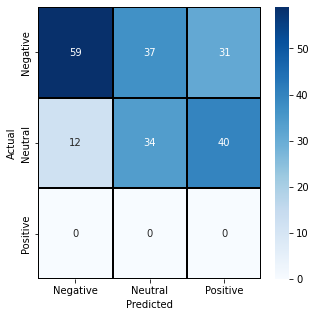

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
cm = confusion_matrix(predictions,y_test)
plt.figure(figsize = (5,5))
sns.heatmap(cm,cmap= "Blues", 
            linecolor = 'black', 
            linewidth = 1, 
            annot = True, 
            fmt='', 
            xticklabels = ['Negative','Neutral','Positive'], 
            yticklabels = ['Negative','Neutral','Positive'])
plt.xlabel("Predicted")
plt.ylabel("Actual")


#### grid search cv

In [ ]:
from sklearn.model_selection import cross_val_predict
from sklearn.model_selection import cross_val_score
from sklearn.svm import SVC
clf = svm.SVC(kernel='linear', C=1, random_state=42)
cvs=cross_val_score(clf,X,y,scoring='accuracy',cv=10)
print('cross_val =  ',cvs.mean())


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example usin

cross_val =   0.6717444065225636


gridsearchCV

In [ ]:

from sklearn.model_selection import GridSearchCV
 
# defining parameter range
param_grid = {'C': [0.1, 1, 10, 100, 1000],
              'gamma': [1, 0.1, 0.01, 0.001, 0.0001],
              'kernel': ['rbf']}
 
grid = GridSearchCV(SVC(), param_grid, refit = True, verbose = 3)
 
# fitting the model for grid search
grid.fit(X_train, y_train)

Fitting 5 folds for each of 25 candidates, totalling 125 fits


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END ........C=0.1, gamma=1, kernel=rbf;, score=0.571 total time=   5.2s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END ........C=0.1, gamma=1, kernel=rbf;, score=0.576 total time=   5.2s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END ........C=0.1, gamma=1, kernel=rbf;, score=0.574 total time=   5.2s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END ........C=0.1, gamma=1, kernel=rbf;, score=0.573 total time=   5.2s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END ........C=0.1, gamma=1, kernel=rbf;, score=0.573 total time=   5.2s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END ......C=0.1, gamma=0.1, kernel=rbf;, score=0.571 total time=   5.1s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END ......C=0.1, gamma=0.1, kernel=rbf;, score=0.576 total time=   5.1s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END ......C=0.1, gamma=0.1, kernel=rbf;, score=0.574 total time=   5.1s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END ......C=0.1, gamma=0.1, kernel=rbf;, score=0.573 total time=   5.1s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END ......C=0.1, gamma=0.1, kernel=rbf;, score=0.573 total time=   4.9s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END .....C=0.1, gamma=0.01, kernel=rbf;, score=0.571 total time=   4.9s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END .....C=0.1, gamma=0.01, kernel=rbf;, score=0.576 total time=   5.0s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END .....C=0.1, gamma=0.01, kernel=rbf;, score=0.574 total time=   5.0s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END .....C=0.1, gamma=0.01, kernel=rbf;, score=0.573 total time=   4.9s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END .....C=0.1, gamma=0.01, kernel=rbf;, score=0.573 total time=   4.9s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END ....C=0.1, gamma=0.001, kernel=rbf;, score=0.571 total time=   4.0s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END ....C=0.1, gamma=0.001, kernel=rbf;, score=0.571 total time=   4.0s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END ....C=0.1, gamma=0.001, kernel=rbf;, score=0.571 total time=   4.0s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END ....C=0.1, gamma=0.001, kernel=rbf;, score=0.571 total time=   3.8s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END ....C=0.1, gamma=0.001, kernel=rbf;, score=0.570 total time=   3.9s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END ...C=0.1, gamma=0.0001, kernel=rbf;, score=0.571 total time=   3.3s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END ...C=0.1, gamma=0.0001, kernel=rbf;, score=0.571 total time=   3.3s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END ...C=0.1, gamma=0.0001, kernel=rbf;, score=0.571 total time=   3.3s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END ...C=0.1, gamma=0.0001, kernel=rbf;, score=0.571 total time=   3.3s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END ...C=0.1, gamma=0.0001, kernel=rbf;, score=0.570 total time=   3.3s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END ..........C=1, gamma=1, kernel=rbf;, score=0.584 total time=   5.2s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END ..........C=1, gamma=1, kernel=rbf;, score=0.575 total time=   5.0s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END ..........C=1, gamma=1, kernel=rbf;, score=0.573 total time=   5.0s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END ..........C=1, gamma=1, kernel=rbf;, score=0.573 total time=   5.0s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END ..........C=1, gamma=1, kernel=rbf;, score=0.575 total time=   5.0s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END ........C=1, gamma=0.1, kernel=rbf;, score=0.584 total time=   5.1s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END ........C=1, gamma=0.1, kernel=rbf;, score=0.575 total time=   4.9s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END ........C=1, gamma=0.1, kernel=rbf;, score=0.574 total time=   4.9s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END ........C=1, gamma=0.1, kernel=rbf;, score=0.574 total time=   5.0s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END ........C=1, gamma=0.1, kernel=rbf;, score=0.575 total time=   5.0s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END .......C=1, gamma=0.01, kernel=rbf;, score=0.583 total time=   4.9s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END .......C=1, gamma=0.01, kernel=rbf;, score=0.581 total time=   5.1s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END .......C=1, gamma=0.01, kernel=rbf;, score=0.580 total time=   5.1s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END .......C=1, gamma=0.01, kernel=rbf;, score=0.579 total time=   5.0s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END .......C=1, gamma=0.01, kernel=rbf;, score=0.582 total time=   4.9s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.648 total time=   4.1s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.648 total time=   4.1s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.625 total time=   4.0s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.645 total time=   3.9s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.635 total time=   4.0s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END .....C=1, gamma=0.0001, kernel=rbf;, score=0.599 total time=   3.3s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END .....C=1, gamma=0.0001, kernel=rbf;, score=0.604 total time=   3.4s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END .....C=1, gamma=0.0001, kernel=rbf;, score=0.603 total time=   3.3s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END .....C=1, gamma=0.0001, kernel=rbf;, score=0.593 total time=   3.3s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END .....C=1, gamma=0.0001, kernel=rbf;, score=0.601 total time=   3.3s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END .........C=10, gamma=1, kernel=rbf;, score=0.584 total time=   5.2s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END .........C=10, gamma=1, kernel=rbf;, score=0.575 total time=   5.2s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END .........C=10, gamma=1, kernel=rbf;, score=0.573 total time=   5.3s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END .........C=10, gamma=1, kernel=rbf;, score=0.573 total time=   5.2s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END .........C=10, gamma=1, kernel=rbf;, score=0.575 total time=   5.3s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END .......C=10, gamma=0.1, kernel=rbf;, score=0.584 total time=   5.2s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END .......C=10, gamma=0.1, kernel=rbf;, score=0.575 total time=   5.2s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END .......C=10, gamma=0.1, kernel=rbf;, score=0.574 total time=   5.1s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END .......C=10, gamma=0.1, kernel=rbf;, score=0.574 total time=   5.2s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END .......C=10, gamma=0.1, kernel=rbf;, score=0.575 total time=   5.2s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END ......C=10, gamma=0.01, kernel=rbf;, score=0.588 total time=   5.1s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END ......C=10, gamma=0.01, kernel=rbf;, score=0.586 total time=   5.1s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END ......C=10, gamma=0.01, kernel=rbf;, score=0.578 total time=   5.1s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END ......C=10, gamma=0.01, kernel=rbf;, score=0.586 total time=   5.1s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END ......C=10, gamma=0.01, kernel=rbf;, score=0.590 total time=   5.2s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END .....C=10, gamma=0.001, kernel=rbf;, score=0.630 total time=   4.3s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END .....C=10, gamma=0.001, kernel=rbf;, score=0.631 total time=   4.3s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END .....C=10, gamma=0.001, kernel=rbf;, score=0.596 total time=   4.4s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END .....C=10, gamma=0.001, kernel=rbf;, score=0.636 total time=   4.3s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END .....C=10, gamma=0.001, kernel=rbf;, score=0.635 total time=   4.4s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END ....C=10, gamma=0.0001, kernel=rbf;, score=0.665 total time=   3.1s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END ....C=10, gamma=0.0001, kernel=rbf;, score=0.670 total time=   3.1s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END ....C=10, gamma=0.0001, kernel=rbf;, score=0.632 total time=   3.0s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END ....C=10, gamma=0.0001, kernel=rbf;, score=0.646 total time=   3.0s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END ....C=10, gamma=0.0001, kernel=rbf;, score=0.659 total time=   3.1s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END ........C=100, gamma=1, kernel=rbf;, score=0.584 total time=   5.3s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END ........C=100, gamma=1, kernel=rbf;, score=0.575 total time=   5.2s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END ........C=100, gamma=1, kernel=rbf;, score=0.573 total time=   5.2s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END ........C=100, gamma=1, kernel=rbf;, score=0.573 total time=   5.2s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END ........C=100, gamma=1, kernel=rbf;, score=0.575 total time=   5.2s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END ......C=100, gamma=0.1, kernel=rbf;, score=0.584 total time=   5.4s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END ......C=100, gamma=0.1, kernel=rbf;, score=0.575 total time=   5.1s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END ......C=100, gamma=0.1, kernel=rbf;, score=0.574 total time=   5.1s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END ......C=100, gamma=0.1, kernel=rbf;, score=0.574 total time=   5.1s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END ......C=100, gamma=0.1, kernel=rbf;, score=0.575 total time=   5.1s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END .....C=100, gamma=0.01, kernel=rbf;, score=0.588 total time=   5.0s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END .....C=100, gamma=0.01, kernel=rbf;, score=0.586 total time=   5.0s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END .....C=100, gamma=0.01, kernel=rbf;, score=0.576 total time=   5.1s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END .....C=100, gamma=0.01, kernel=rbf;, score=0.586 total time=   4.9s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END .....C=100, gamma=0.01, kernel=rbf;, score=0.591 total time=   5.0s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END ....C=100, gamma=0.001, kernel=rbf;, score=0.633 total time=   4.4s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END ....C=100, gamma=0.001, kernel=rbf;, score=0.628 total time=   4.5s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END ....C=100, gamma=0.001, kernel=rbf;, score=0.596 total time=   4.4s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END ....C=100, gamma=0.001, kernel=rbf;, score=0.623 total time=   4.4s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END ....C=100, gamma=0.001, kernel=rbf;, score=0.625 total time=   4.4s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END ...C=100, gamma=0.0001, kernel=rbf;, score=0.632 total time=   3.4s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END ...C=100, gamma=0.0001, kernel=rbf;, score=0.659 total time=   3.4s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END ...C=100, gamma=0.0001, kernel=rbf;, score=0.595 total time=   3.3s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END ...C=100, gamma=0.0001, kernel=rbf;, score=0.632 total time=   3.3s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END ...C=100, gamma=0.0001, kernel=rbf;, score=0.652 total time=   3.4s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END .......C=1000, gamma=1, kernel=rbf;, score=0.584 total time=   5.2s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END .......C=1000, gamma=1, kernel=rbf;, score=0.575 total time=   5.1s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END .......C=1000, gamma=1, kernel=rbf;, score=0.573 total time=   5.2s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END .......C=1000, gamma=1, kernel=rbf;, score=0.573 total time=   5.1s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END .......C=1000, gamma=1, kernel=rbf;, score=0.575 total time=   5.2s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END .....C=1000, gamma=0.1, kernel=rbf;, score=0.584 total time=   5.1s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END .....C=1000, gamma=0.1, kernel=rbf;, score=0.575 total time=   5.2s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END .....C=1000, gamma=0.1, kernel=rbf;, score=0.574 total time=   5.2s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END .....C=1000, gamma=0.1, kernel=rbf;, score=0.574 total time=   5.1s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END .....C=1000, gamma=0.1, kernel=rbf;, score=0.575 total time=   5.1s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END ....C=1000, gamma=0.01, kernel=rbf;, score=0.588 total time=   4.9s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END ....C=1000, gamma=0.01, kernel=rbf;, score=0.586 total time=   5.0s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END ....C=1000, gamma=0.01, kernel=rbf;, score=0.576 total time=   5.0s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END ....C=1000, gamma=0.01, kernel=rbf;, score=0.586 total time=   4.9s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END ....C=1000, gamma=0.01, kernel=rbf;, score=0.591 total time=   5.0s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END ...C=1000, gamma=0.001, kernel=rbf;, score=0.637 total time=   4.3s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END ...C=1000, gamma=0.001, kernel=rbf;, score=0.615 total time=   4.4s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END ...C=1000, gamma=0.001, kernel=rbf;, score=0.597 total time=   4.3s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END ...C=1000, gamma=0.001, kernel=rbf;, score=0.620 total time=   4.4s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END ...C=1000, gamma=0.001, kernel=rbf;, score=0.620 total time=   4.3s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/5] END ..C=1000, gamma=0.0001, kernel=rbf;, score=0.596 total time=   5.6s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/5] END ..C=1000, gamma=0.0001, kernel=rbf;, score=0.632 total time=   5.5s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/5] END ..C=1000, gamma=0.0001, kernel=rbf;, score=0.584 total time=   5.4s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/5] END ..C=1000, gamma=0.0001, kernel=rbf;, score=0.619 total time=   5.5s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/5] END ..C=1000, gamma=0.0001, kernel=rbf;, score=0.614 total time=   5.3s


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


GridSearchCV(estimator=SVC(),
             param_grid={'C': [0.1, 1, 10, 100, 1000],
                         'gamma': [1, 0.1, 0.01, 0.001, 0.0001],
                         'kernel': ['rbf']},
             verbose=3)

In [ ]:

# print best parameter after tuning
print(grid.best_params_)
 
# print how our model looks after hyper-parameter tuning
print(grid.best_estimator_)

{'C': 10, 'gamma': 0.0001, 'kernel': 'rbf'}
SVC(C=10, gamma=0.0001)


In [ ]:

grid_predictions = grid.predict(X_test)
 
# print classification report
print(classification_report(y_test, grid_predictions))

              precision    recall  f1-score   support

          -1       0.54      0.79      0.64        71
           0       0.41      0.61      0.49        71
           1       0.83      0.07      0.13        71

    accuracy                           0.49       213
   macro avg       0.60      0.49      0.42       213
weighted avg       0.60      0.49      0.42       213



Text(23.999999999999996, 0.5, 'Actual')

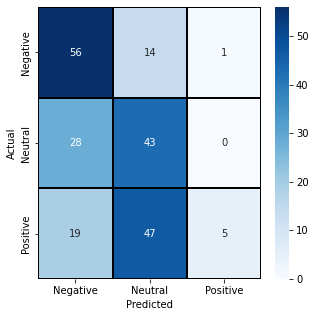

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
cm = confusion_matrix(y_test, grid_predictions)
plt.figure(figsize = (5,5))
sns.heatmap(cm,cmap= "Blues", 
            linecolor = 'black', 
            linewidth = 1, 
            annot = True, 
            fmt='', 
            xticklabels = ['Negative','Neutral','Positive'], 
            yticklabels = ['Negative','Neutral','Positive'])
plt.xlabel("Predicted")
plt.ylabel("Actual")



###Naive bayes

In [ ]:
from sklearn.naive_bayes import MultinomialNB
from sklearn.metrics import classification_report

In [ ]:
MNB = MultinomialNB()
MNB.get_params().keys()


####grid search cv

In [ ]:

from sklearn.model_selection import GridSearchCV
 
# defining parameter range
param_grid = { 'alpha':[0.01, 0.1, 1, 10, 100]}
 
grid = GridSearchCV(MNB, param_grid, refit = True, verbose = 3)
 
# fitting the model for grid search
grid.fit(X_train, y_train)

In [ ]:

# print best parameter after tuning
print(grid.best_params_)
 
# print how our model looks after hyper-parameter tuning
print(grid.best_estimator_)

In [ ]:

grid_predictions = grid.predict(X_test)
 
# print classification report
print(classification_report(y_test, grid_predictions))

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
cm = confusion_matrix(y_test, grid_predictions)
plt.figure(figsize = (5,5))
sns.heatmap(cm,cmap= "Blues", 
            linecolor = 'black', 
            linewidth = 1, 
            annot = True, 
            fmt='', 
            xticklabels = ['Negative','Neutral','Positive'], 
            yticklabels = ['Negative','Neutral','Positive'])
plt.xlabel("Predicted")
plt.ylabel("Actual")